#### **LSE Data Analytics Online Career Accelerator** 
#### Course 201: Data Analytics with Python

## Assignment template: Covid data

## Student Note
This template can be used to better understand the suggested workflow and how to approach the questions. You are welcome to add code and markdown blocks to the various sections to add either code or comments. Make sure to add code cells as applicable, and to comment all your code blocks.

You have the option to populate your notebook with all the elements typically contained within the report, or to submit a separate report. In the case of submitting your notebook, you can embed images, links and text where appropriate in addition to the text notes added.

**SPECIAL NOTE**
- Submit your Jupyter Notebook with the following naming convention: `LSE_DA201_assignment_[your name]_[your surname]`
- You should submit a zipped folder containing all the elements used in your notebook (data files, images, etc)

> ***Markdown notes:*** Remember to change cell types to `Markdown` and take a look here: [Markdown basics](https://docs.github.com/en/get-started/writing-on-github/getting-started-with-writing-and-formatting-on-github/basic-writing-and-formatting-syntax) to add formatted text, links and images to your markdown documents.

### 0) Environment preparation
These settings are provided for you. You do not need to make any changes.

In [337]:
# Import the required libraries and set plotting options
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

sns.set(rc = {'figure.figsize':(15,10)})

### 1) Assignment activity 1: [Prepare your GitHub repository](https://fourthrev.instructure.com/courses/313/pages/assignment-activity-1-prepare-your-github-repository?module_item_id=20647)

#### 1.1) Report/notebook expectations:
- Demonstrate your GitHub setup consisting of the load and push updates of all the Jupyter Notebook files. (**Hint**: Make sure that your github username, the directory structure and updates are visible in the screenshot. Make sure to provide a zipped copy of the folder containing your submission notebook as well as supporting files such as images used in the notebook.)

#### Required: Report submission:
Insert URL to your public GitHub repository and a screenshot (double click cell to edit)
- [My Github Repo](https://github.com/byaraman/LSE_DA_COVID_analysis_BYA)
- Screenshot demo (replace with your own)

!['My Github screenshot](http://github.com/apvoges/lse-ca/blob/main/GitHubScreenshot.png?raw=true)
(Note that this only works if your repo is set to **public**. Alternatively you need to refer to a local image and include this image in your submission.)

#### 1.2) Presentation expectations:
- Describe the role and how workflow tools such as Github can be used to add value to organisations.

#### Optional for notebook/Required for presentation.
- You can use this cell as placeholder for bulletpoints to include in your presentation. 
- Note that this section will not be graded in the notebook, grades awarded based on presentation content only. 



GitHub is the tried and trusted place for housing code, controlling changes over time, and working with and learning from others.
- It can help you avoid losing work if you accidentally overwrite something or want to reuse code.
- It is an ideal option for collaborating with others (ie teamwork) and establishing a clear and reversible change history. 
- It is also an ideal platform to support a learning organisation (a learning organization is a company that facilitates the learning of its members and continuously transforms itself) since it allows to create a project or page to experiment and test ideas. Hosting the explorations on GitHub helps one to improve his/her skills faster because he/she can get valuable feedback from others. Building and maintaining a knowledge bank of the codes, projects, and programs, which can be revisited lies at the heart of continuous learning.




### 2) Assignment activity 2: [Import and explore data](https://fourthrev.instructure.com/courses/313/pages/assignment-activity-2-import-and-explore-the-data?module_item_id=20648)

#### 2.1) Report expectations:
- Load the files `covid_19_uk_cases.csv` and `covid_19_uk_vaccinated.csv` and explore the data.
- Explore the data using the `info()`, `describe()`, `shape` and `value_counts()` methods, and note the observations regarding data types, number or records and features
- Identify missing data
- Filter/subset data
- Aggregate data (totals and by month)
- Note observations

Data fileları değiştirme ile ilgili yorumlatr ve screenshotlar

In [2]:
# Load the covid cases and vaccine data sets as cov and vac respectively
# The source files have been modified before beng uploaded: 
# Saint Helena, Ascension and Tristan da Cunha is replaced by Saint Helena and Ascension and Tristan da Cunha 
# in order to avoid possible confusion with delimitter ,

In [346]:
cov = pd.read_csv('covid_19_uk_cases_BYA.csv')
vac = pd.read_csv('covid_19_uk_vaccinated_BYA.csv')

In [310]:
# Explore the DataFrames with the appropriate functions
cov.info()
cov.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7584 entries, 0 to 7583
Data columns (total 12 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Province/State            7584 non-null   object 
 1   Country/Region            7584 non-null   object 
 2   Lat                       7584 non-null   float64
 3   Long                      7584 non-null   float64
 4   ISO 3166-1 Alpha 3-Codes  7584 non-null   object 
 5   Sub-region Name           7584 non-null   object 
 6   Intermediate Region Code  7584 non-null   int64  
 7   Date                      7584 non-null   object 
 8   Deaths                    7582 non-null   float64
 9   Cases                     7582 non-null   float64
 10  Recovered                 7582 non-null   float64
 11  Hospitalised              7582 non-null   float64
dtypes: float64(6), int64(1), object(5)
memory usage: 711.1+ KB


,Lat,Long,Intermediate Region Code,Deaths,Cases,Recovered,Hospitalised
count,7584.000000,7584.000000,7584.000000,7582.000000,7.582000e+03,7582.000000,7582.000000
mean,21.840267,-41.440047,12.500000,6210.202321,2.147082e+05,454.691242,685.228568
std,28.305518,30.527529,14.009849,24860.790148,1.007557e+06,1010.642337,819.256635
min,-51.796300,-81.254600,0.000000,0.000000,0.000000e+00,0.000000,0.000000
25%,17.851074,-64.667625,0.000000,0.000000,1.200000e+01,0.000000,105.000000
50%,20.503650,-60.855483,2.500000,1.000000,1.685000e+02,13.000000,390.000000
75%,39.448675,-5.152225,29.000000,25.000000,1.585000e+03,312.000000,955.750000
max,55.378100,-2.364400,29.000000,138237.000000,8.317439e+06,8322.000000,4907.000000


Initial findings (1):
- cov.info () tells that there are missing values at 2 lines of cov data
- 'Date' datatype is object. In order to be able to utilise it properly further down the analysis, converting it to datetime would be optimum.
- Datatype of Deaths, Cases, Recovered and Hospitalised are float64. However, they could be converted into int64 as they will always be integer numbers.
- In cov.describe () the data is broken down into 3 quartiles. The first quartile (Q1) has the first 25% values below it, the second quartile has the first 50% of the values below it (the median) and so and so forth. When compared with the case numbers the recovered numbers are fairly low (%50 of the values are below 13) which might be pointing to a problem in the data.

In [314]:
# Summarise cov.info() in a simplified format 
print(cov.shape)
print(cov.dtypes)

(7584, 12)
Province/State               object
Country/Region               object
Lat                         float64
Long                        float64
ISO 3166-1 Alpha 3-Codes     object
Sub-region Name              object
Intermediate Region Code      int64
Date                         object
Deaths                      float64
Cases                       float64
Recovered                   float64
Hospitalised                float64
dtype: object


In [361]:
# Visualise the data
cov.head()

,Province/State,Country/Region,Lat,Long,ISO 3166-1 Alpha 3-Codes,Sub-region Name,Intermediate Region Code,Date,Deaths,Cases,Recovered,Hospitalised
0,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-22,0.0,0.0,0.0,0.0
1,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-23,0.0,0.0,0.0,0.0
2,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-24,0.0,0.0,0.0,0.0
3,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-25,0.0,0.0,0.0,0.0
4,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-26,0.0,0.0,0.0,0.0


In [313]:
# Visualise the data
cov.tail()

,Province/State,Country/Region,Lat,Long,ISO 3166-1 Alpha 3-Codes,Sub-region Name,Intermediate Region Code,Date,Deaths,Cases,Recovered,Hospitalised
7579,Others,United Kingdom,55.3781,-3.436,GBR,Northern Europe,0,2021-10-10,137735.0,8154306.0,0.0,378.0
7580,Others,United Kingdom,55.3781,-3.436,GBR,Northern Europe,0,2021-10-11,137763.0,8193769.0,0.0,386.0
7581,Others,United Kingdom,55.3781,-3.436,GBR,Northern Europe,0,2021-10-12,137944.0,8231437.0,0.0,386.0
7582,Others,United Kingdom,55.3781,-3.436,GBR,Northern Europe,0,2021-10-13,138080.0,8272883.0,0.0,0.0
7583,Others,United Kingdom,55.3781,-3.436,GBR,Northern Europe,0,2021-10-14,138237.0,8317439.0,0.0,0.0


In [347]:
# Validate the number of rows with missing data
cov_na = cov[cov.isna().any(axis=1)]
cov_na.shape

(2, 12)

In [348]:
# Filter rows with missing data
cov_na

,Province/State,Country/Region,Lat,Long,ISO 3166-1 Alpha 3-Codes,Sub-region Name,Intermediate Region Code,Date,Deaths,Cases,Recovered,Hospitalised
875,Bermuda,United Kingdom,32.3078,-64.7505,BMU,Northern America,0,2020-09-21,NaN,NaN,NaN,NaN
876,Bermuda,United Kingdom,32.3078,-64.7505,BMU,Northern America,0,2020-09-22,NaN,NaN,NaN,NaN


In [352]:
# Sum the missing values
cov['Deaths'].isnull().sum()

2

In [353]:
# replace missing values with forward fill 
cov['Deaths'] = cov['Deaths'].fillna(method='ffill')

# sum of missing values
cov['Deaths'].isnull().sum()


0

In [354]:
# replace missing values with forward fill 
cov['Cases'] = cov['Cases'].fillna(method='ffill')

# sum of missing values
cov['Cases'].isnull().sum()

0

In [355]:
# replace missing values with forward fill 
cov['Recovered'] = cov['Recovered'].fillna(method='ffill')

# sum of missing values
cov['Recovered'].isnull().sum()

0

In [356]:
# replace missing values with forward fill 
cov['Hospitalised'] = cov['Hospitalised'].fillna(method='ffill')

# sum of missing values
cov['Hospitalised'].isnull().sum()

0

Actions relating to initial findings:
The missing values are captured and filled with forwardfill method.

In [371]:
cov.astype({'Deaths': 'int64', 'Cases': 'int64', 'Recovered': 'int64', 'Hospitalised': 'int64'}).dtypes

Province/State               object
Country/Region               object
Lat                         float64
Long                        float64
ISO 3166-1 Alpha 3-Codes     object
Sub-region Name              object
Intermediate Region Code      int64
Date                         object
Deaths                        int64
Cases                         int64
Recovered                     int64
Hospitalised                  int64
dtype: object

Actions relating to initial findings: Datatype of Deaths, Cases, Recovered and Hospitalised were float64. They are converted into int64 as they will always be integer numbers.

In [8]:
# Explore the DataFrames with the appropriate functions
vac.info()
vac.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7584 entries, 0 to 7583
Data columns (total 11 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Province/State            7584 non-null   object 
 1   Country/Region            7584 non-null   object 
 2   Lat                       7584 non-null   float64
 3   Long                      7584 non-null   float64
 4   ISO 3166-1 Alpha 3-Codes  7584 non-null   object 
 5   Sub-region Name           7584 non-null   object 
 6   Intermediate Region Code  7584 non-null   int64  
 7   Date                      7584 non-null   object 
 8   Vaccinated                7584 non-null   int64  
 9   First Dose                7584 non-null   int64  
 10  Second Dose               7584 non-null   int64  
dtypes: float64(2), int64(4), object(5)
memory usage: 651.9+ KB


,Lat,Long,Intermediate Region Code,Vaccinated,First Dose,Second Dose
count,7584.000000,7584.000000,7584.000000,7584.000000,7584.000000,7584.000000
mean,21.840267,-41.440047,12.500000,5913.547600,6192.822257,5913.547600
std,28.305518,30.527529,14.009849,10846.410258,11439.883647,10846.410258
min,-51.796300,-81.254600,0.000000,0.000000,0.000000,0.000000
25%,17.851074,-64.667625,0.000000,0.000000,0.000000,0.000000
50%,20.503650,-60.855483,2.500000,0.000000,0.000000,0.000000
75%,39.448675,-5.152225,29.000000,8338.000000,7505.500000,8338.000000
max,55.378100,-2.364400,29.000000,69619.000000,94038.000000,69619.000000


Initial findings (2):

- In vac.describe () the data is broken down into 3 quartiles. The first quartile (Q1) has the first 25% values below it, the second quartile has the first 50% of the values below it (the median) and so and so forth. %50 of the values are 0 for  Vaccinated/First Dose/Second Dose verifying that the vaccinations have started at the beginning of 2021.

In [315]:
# Summarise cov.info() in a simplified format 
print(vac.shape)
print(vac.dtypes)

(7584, 11)
Province/State               object
Country/Region               object
Lat                         float64
Long                        float64
ISO 3166-1 Alpha 3-Codes     object
Sub-region Name              object
Intermediate Region Code      int64
Date                         object
Vaccinated                    int64
First Dose                    int64
Second Dose                   int64
dtype: object


In [316]:
# Visualise the data
vac.head()

,Province/State,Country/Region,Lat,Long,ISO 3166-1 Alpha 3-Codes,Sub-region Name,Intermediate Region Code,Date,Vaccinated,First Dose,Second Dose
0,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-22,0,0,0
1,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-23,0,0,0
2,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-24,0,0,0
3,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-25,0,0,0
4,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-26,0,0,0


In [11]:
# Visualise the data
vac.tail()

,Province/State,Country/Region,Lat,Long,ISO 3166-1 Alpha 3-Codes,Sub-region Name,Intermediate Region Code,Date,Vaccinated,First Dose,Second Dose
7579,Others,United Kingdom,55.3781,-3.436,GBR,Northern Europe,0,2021-10-10,1070,1216,1070
7580,Others,United Kingdom,55.3781,-3.436,GBR,Northern Europe,0,2021-10-11,1300,1604,1300
7581,Others,United Kingdom,55.3781,-3.436,GBR,Northern Europe,0,2021-10-12,1482,2027,1482
7582,Others,United Kingdom,55.3781,-3.436,GBR,Northern Europe,0,2021-10-13,0,0,0
7583,Others,United Kingdom,55.3781,-3.436,GBR,Northern Europe,0,2021-10-14,0,0,0


In [359]:
# Create DataFrame based on Gibraltar data
# Hint: newdf = df[df[col]==index]
# print the whole DataFrame - by displaying max rows

cov_GIB = cov[cov['Province/State']=='Gibraltar']
pd.set_option("display.max_rows", None)
cov_GIB

,Province/State,Country/Region,Lat,Long,ISO 3166-1 Alpha 3-Codes,Sub-region Name,Intermediate Region Code,Date,Deaths,Cases,Recovered,Hospitalised
3792,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-22,0.0,0.0,0.0,0.0
3793,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-23,0.0,0.0,0.0,0.0
3794,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-24,0.0,0.0,0.0,0.0
3795,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-25,0.0,0.0,0.0,0.0
3796,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-26,0.0,0.0,0.0,0.0
3797,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-27,0.0,0.0,0.0,0.0
3798,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-28,0.0,0.0,0.0,0.0
3799,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-29,0.0,0.0,0.0,0.0
3800,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-30,0.0,0.0,0.0,0.0
3801,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-31,0.0,0.0,0.0,0.0


In [367]:
cov_GIB.dtypes

Province/State               object
Country/Region               object
Lat                         float64
Long                        float64
ISO 3166-1 Alpha 3-Codes     object
Sub-region Name              object
Intermediate Region Code      int64
Date                         object
Deaths                      float64
Cases                       float64
Recovered                   float64
Hospitalised                float64
dtype: object

In [340]:
vac_GIB = vac[vac['Province/State']=='Gibraltar']
pd.set_option("display.max_rows", None)
vac_GIB

,Province/State,Country/Region,Lat,Long,ISO 3166-1 Alpha 3-Codes,Sub-region Name,Intermediate Region Code,Date,Vaccinated,First Dose,Second Dose
3792,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-22,0,0,0
3793,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-23,0,0,0
3794,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-24,0,0,0
3795,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-25,0,0,0
3796,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-26,0,0,0
3797,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-27,0,0,0
3798,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-28,0,0,0
3799,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-29,0,0,0
3800,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-30,0,0,0
3801,Gibraltar,United Kingdom,36.1408,-5.3536,GIB,Southern Europe,0,2020-01-31,0,0,0


In [360]:
#Subset the Gibraltar DataFrame that you have created consisting of the following columns: 
#Deaths, Cases, Recovered and Hospitalised.
cov_GIB_data = cov_GIB[['Province/State', 'Country/Region', 'Date','Deaths','Cases', 'Recovered', 'Hospitalised']]
cov_GIB_data

,Province/State,Country/Region,Date,Deaths,Cases,Recovered,Hospitalised
3792,Gibraltar,United Kingdom,2020-01-22,0.0,0.0,0.0,0.0
3793,Gibraltar,United Kingdom,2020-01-23,0.0,0.0,0.0,0.0
3794,Gibraltar,United Kingdom,2020-01-24,0.0,0.0,0.0,0.0
3795,Gibraltar,United Kingdom,2020-01-25,0.0,0.0,0.0,0.0
3796,Gibraltar,United Kingdom,2020-01-26,0.0,0.0,0.0,0.0
3797,Gibraltar,United Kingdom,2020-01-27,0.0,0.0,0.0,0.0
3798,Gibraltar,United Kingdom,2020-01-28,0.0,0.0,0.0,0.0
3799,Gibraltar,United Kingdom,2020-01-29,0.0,0.0,0.0,0.0
3800,Gibraltar,United Kingdom,2020-01-30,0.0,0.0,0.0,0.0
3801,Gibraltar,United Kingdom,2020-01-31,0.0,0.0,0.0,0.0


In [15]:
# Explore the Gibraaltar covid cases dataFrame
cov_GIB_data.describe()

,Deaths,Cases,Recovered,Hospitalised
count,632.000000,632.000000,632.000000,632.000000
mean,40.208861,2237.109177,1512.821203,1027.625000
std,45.332832,2136.268090,1817.096755,1145.681058
min,0.000000,0.000000,0.000000,0.000000
25%,0.000000,177.000000,109.500000,157.750000
50%,5.000000,1036.500000,323.500000,675.500000
75%,94.000000,4286.000000,4122.500000,1548.000000
max,97.000000,5727.000000,4670.000000,4907.000000


In [341]:
#Subset the Gibraltar DataFrame 
vac_GIB_data = vac_GIB[['Province/State', 'Country/Region', 'Date', 'Vaccinated', 'First Dose', 'Second Dose']]
vac_GIB_data

,Province/State,Country/Region,Date,Vaccinated,First Dose,Second Dose
3792,Gibraltar,United Kingdom,2020-01-22,0,0,0
3793,Gibraltar,United Kingdom,2020-01-23,0,0,0
3794,Gibraltar,United Kingdom,2020-01-24,0,0,0
3795,Gibraltar,United Kingdom,2020-01-25,0,0,0
3796,Gibraltar,United Kingdom,2020-01-26,0,0,0
3797,Gibraltar,United Kingdom,2020-01-27,0,0,0
3798,Gibraltar,United Kingdom,2020-01-28,0,0,0
3799,Gibraltar,United Kingdom,2020-01-29,0,0,0
3800,Gibraltar,United Kingdom,2020-01-30,0,0,0
3801,Gibraltar,United Kingdom,2020-01-31,0,0,0


In [342]:
# Explore the Gibraaltar vaccination dataFrame
vac_GIB_data.describe()

,Vaccinated,First Dose,Second Dose
count,632.000000,632.000000,632.000000
mean,8870.318038,9289.218354,8870.318038
std,15439.487761,16287.230372,15439.487761
min,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000
75%,14594.000000,12488.750000,14594.000000
max,69619.000000,94038.000000,69619.000000


In [50]:
# Explore behaviour over time
# Details of dataframe covid_summary can be found in the 3rd part of the report.

In [331]:
covid_summary_GIB = covid_summary[covid_summary['Province/State'] == 'Gibraltar']
covid_summary_GIB 

,Province/State,Country/Region,Date,Vaccinated,First Dose,Second Dose,Deaths,Cases,Recovered,Hospitalised,Year_Month
3792,Gibraltar,United Kingdom,2020-01-22,0,0,0,0.0,0.0,0.0,0.0,2020-01
3793,Gibraltar,United Kingdom,2020-01-23,0,0,0,0.0,0.0,0.0,0.0,2020-01
3794,Gibraltar,United Kingdom,2020-01-24,0,0,0,0.0,0.0,0.0,0.0,2020-01
3795,Gibraltar,United Kingdom,2020-01-25,0,0,0,0.0,0.0,0.0,0.0,2020-01
3796,Gibraltar,United Kingdom,2020-01-26,0,0,0,0.0,0.0,0.0,0.0,2020-01
3797,Gibraltar,United Kingdom,2020-01-27,0,0,0,0.0,0.0,0.0,0.0,2020-01
3798,Gibraltar,United Kingdom,2020-01-28,0,0,0,0.0,0.0,0.0,0.0,2020-01
3799,Gibraltar,United Kingdom,2020-01-29,0,0,0,0.0,0.0,0.0,0.0,2020-01
3800,Gibraltar,United Kingdom,2020-01-30,0,0,0,0.0,0.0,0.0,0.0,2020-01
3801,Gibraltar,United Kingdom,2020-01-31,0,0,0,0.0,0.0,0.0,0.0,2020-01


In [333]:
#In order to summarise covid_summary_GIB group by is applied using the Year_Month column.
covid_summary_GIB_groupby_year_month = covid_summary_GIB.groupby(['Year_Month']).sum()  
covid_summary_GIB_groupby_year_month

,Vaccinated,First Dose,Second Dose,Deaths,Cases,Recovered,Hospitalised
Year_Month,,,,,,,
2020-01,0,0,0,0.0,0.0,0.0,0.0
2020-02,0,0,0,0.0,0.0,0.0,0.0
2020-03,0,0,0,0.0,474.0,153.0,6096.0
2020-04,0,0,0,0.0,3737.0,2833.0,69420.0
2020-05,0,0,0,0.0,4650.0,4430.0,41418.0
2020-06,0,0,0,0.0,5265.0,5080.0,18689.0
2020-07,0,0,0,0.0,5619.0,5531.0,7765.0
2020-08,0,0,0,0.0,6936.0,6088.0,3846.0
2020-09,0,0,0,0.0,10175.0,9022.0,4951.0


In [ ]:
# Explore and note observations

Observations with respect to behaviour over time: 
- Vaccinations start as of 01.2021. As of March 2021, first dose numbers make a peak. The following month second dose vaccinations are started. Starting from 06.2021, both first dose and second dose vaccination numbers gradually decrease over time. 
- As the case numbers increase over time, the hospitalised numbers make 2 sharp increases till vaccinations start. Following the vaccinations, hospitalised figures decrease significantly. However, the last three months (from 08.2021 on) there is a significant increase which validates the government's efforts to promote the vaccine. Moreover, the case numbers that stopped their sharp increase in the first months of vaccination, have started to raise again in the final months.
- When the recovery figures are checked it looks like there is a data entry problem in 08.2021 since there is a sharp decrease in the recoveries.
- Vaccination related figures are missing for 13th and 14th of October 2021 as well as the Recovered and Hospitalised.
- Vaccinated column and Second Dose column are identical. we understand that anyone who had the second dose is recored as fully vaccinated.
- Whether there are any cumulative columns will be further investigated.

In [ ]:
# Are there any of the visualisations that could be added here to make it easier?

<AxesSubplot:>

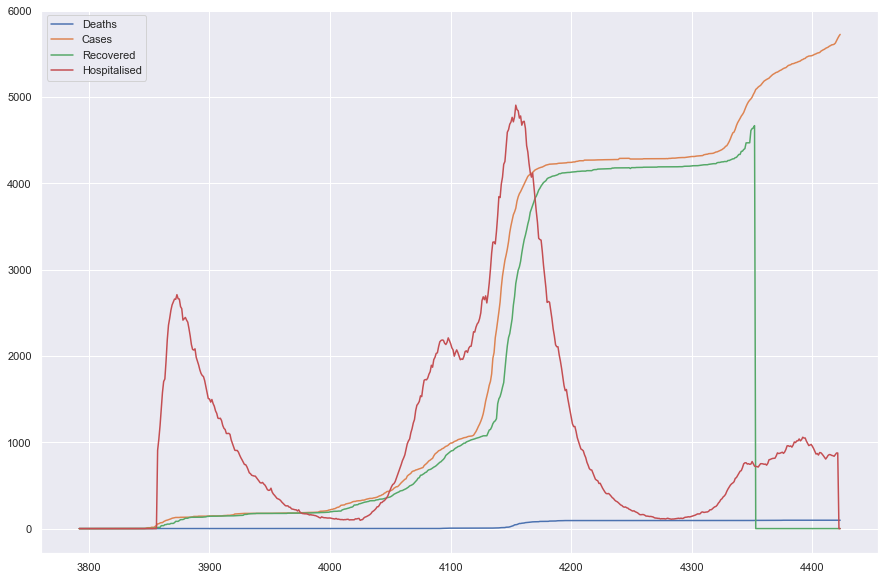

In [343]:
cov_GIB_data.plot()

<AxesSubplot:>

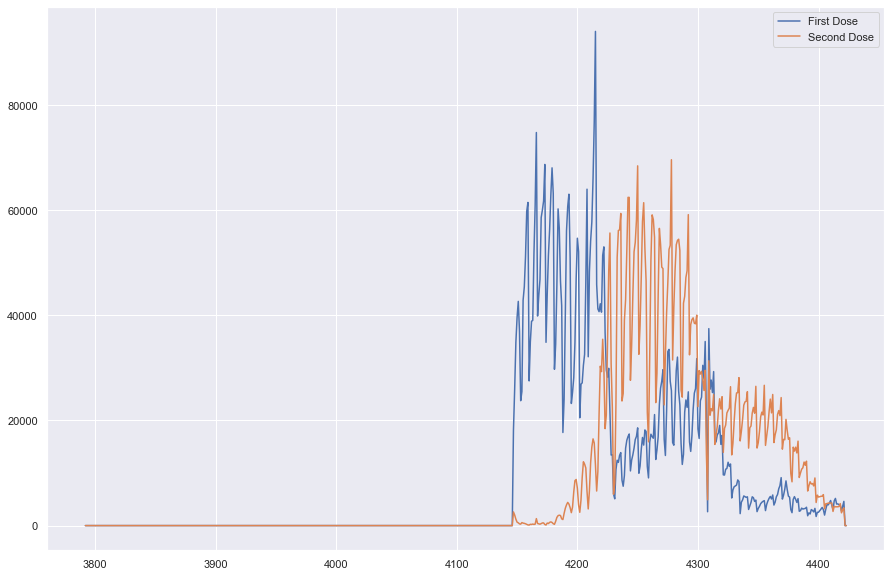

In [344]:
vac_GIB[['First Dose', 'Second Dose']].plot()

The visualisations validate the bove observations with respect to behaviour over time.

In [ ]:
fill the missing data - ffill

#### 2.2) Presentation expectations:
Use the process of exploring the data for Gibraltar as example to provide a brief description of the various phases to help your team to understand the process. Keep it high level and make sure to focus on both specifics relating to the case (first dose, second dose per region, total and over time) and brief observations regarding the process. Assignment two considers basic data exploration.
- Can we make decisions based on total numbers only, or do trends over time offer additional insights?
- Why it is important to explore the data, what are the typical mistakes made in this phase?

- Making decisions only based on number can be misleading in some cases. For example the pluses and minuses would add up to zero. However, seeing the fluctuations in the data will add more insight in understanding the reasons or the background. Averaging the data wouldn't be of value if the data set is fluctuating.
- Moreover visualisations have a powerful effect in realising the anomalies or extremes in the data set - eg recovery data is mising. It is easier to see the trends - eg the timing of fluctuations in first dose and second dose vaccines makes sense when they are plotted over time.

- If we do not explore the data properly and clean, transform, and organise as necessary effective analytics can not take place. If we do not go after the missing data, convert the data into usable format etc we are risking of getting stuck with our analysis at some point or getting a misleading result.  A lot of data scientists will tell you that the initial steps of obtaining and cleaning data, constitute 80% of their job. So dont underestimate the power of data wrangling.

### 3) Assignment activity 3: [Merge and analyse the data](https://fourthrev.instructure.com/courses/313/pages/assignment-activity-3-merge-and-analyse-the-data?module_item_id=20649)

#### 3.1) Report expectations:
- Merge and explore the data
- Convert the data type of the Date column from object to datetime
- Create a dataset that meets the expected parameters
- Add calculated features to dataframes (difference between first and second dose vaccinations)
- Filter and sort output
- Observe totals and percentages as a total and over time
- Note observations

Merge the DataFrames without duplicating columns. The new DataFrame (e.g. `covid`) will have `7584` rows and the following columns: Province/State, Country/Region, Date, Vaccinated, First Dose, Second Dose, Deaths, Cases, Recovered, Hospitalised.

In [364]:
# Join the DataFrames as covid where you merge cov and vac
covid = pd.merge(vac,cov,how='outer')
print(covid.shape)
covid.head()

(7584, 15)


,Province/State,Country/Region,Lat,Long,ISO 3166-1 Alpha 3-Codes,Sub-region Name,Intermediate Region Code,Date,Vaccinated,First Dose,Second Dose,Deaths,Cases,Recovered,Hospitalised
0,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-22,0,0,0,0.0,0.0,0.0,0.0
1,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-23,0,0,0,0.0,0.0,0.0,0.0
2,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-24,0,0,0,0.0,0.0,0.0,0.0
3,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-25,0,0,0,0.0,0.0,0.0,0.0
4,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-26,0,0,0,0.0,0.0,0.0,0.0


In [365]:
covid.tail()

,Province/State,Country/Region,Lat,Long,ISO 3166-1 Alpha 3-Codes,Sub-region Name,Intermediate Region Code,Date,Vaccinated,First Dose,Second Dose,Deaths,Cases,Recovered,Hospitalised
7579,Others,United Kingdom,55.3781,-3.436,GBR,Northern Europe,0,2021-10-10,1070,1216,1070,137735.0,8154306.0,0.0,378.0
7580,Others,United Kingdom,55.3781,-3.436,GBR,Northern Europe,0,2021-10-11,1300,1604,1300,137763.0,8193769.0,0.0,386.0
7581,Others,United Kingdom,55.3781,-3.436,GBR,Northern Europe,0,2021-10-12,1482,2027,1482,137944.0,8231437.0,0.0,386.0
7582,Others,United Kingdom,55.3781,-3.436,GBR,Northern Europe,0,2021-10-13,0,0,0,138080.0,8272883.0,0.0,0.0
7583,Others,United Kingdom,55.3781,-3.436,GBR,Northern Europe,0,2021-10-14,0,0,0,138237.0,8317439.0,0.0,0.0


In [363]:
# Explore the new DataFrame
covid.info()
covid.describe()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7584 entries, 0 to 7583
Data columns (total 15 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Province/State            7584 non-null   object 
 1   Country/Region            7584 non-null   object 
 2   Lat                       7584 non-null   float64
 3   Long                      7584 non-null   float64
 4   ISO 3166-1 Alpha 3-Codes  7584 non-null   object 
 5   Sub-region Name           7584 non-null   object 
 6   Intermediate Region Code  7584 non-null   int64  
 7   Date                      7584 non-null   object 
 8   Vaccinated                7584 non-null   int64  
 9   First Dose                7584 non-null   int64  
 10  Second Dose               7584 non-null   int64  
 11  Deaths                    7584 non-null   float64
 12  Cases                     7584 non-null   float64
 13  Recovered                 7584 non-null   float64
 14  Hospital

,Lat,Long,Intermediate Region Code,Vaccinated,First Dose,Second Dose,Deaths,Cases,Recovered,Hospitalised
count,7584.000000,7584.000000,7584.000000,7584.000000,7584.000000,7584.000000,7584.000000,7.584000e+03,7584.000000,7584.000000
mean,21.840267,-41.440047,12.500000,5913.547600,6192.822257,5913.547600,6208.566983,2.146516e+05,454.615111,685.070016
std,28.305518,30.527529,14.009849,10846.410258,11439.883647,10846.410258,24857.715398,1.007430e+06,1010.519924,819.206766
min,-51.796300,-81.254600,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000
25%,17.851074,-64.667625,0.000000,0.000000,0.000000,0.000000,0.000000,1.200000e+01,0.000000,105.000000
50%,20.503650,-60.855483,2.500000,0.000000,0.000000,0.000000,1.000000,1.690000e+02,13.000000,390.000000
75%,39.448675,-5.152225,29.000000,8338.000000,7505.500000,8338.000000,25.000000,1.585000e+03,312.000000,955.250000
max,55.378100,-2.364400,29.000000,69619.000000,94038.000000,69619.000000,138237.000000,8.317439e+06,8322.000000,4907.000000


In [326]:
# Fix the date column data type
covid['Date'] = pd.to_datetime(covid['Date'])
covid.dtypes

Province/State                      object
Country/Region                      object
Lat                                float64
Long                               float64
ISO 3166-1 Alpha 3-Codes            object
Sub-region Name                     object
Intermediate Region Code             int64
Date                        datetime64[ns]
Vaccinated                           int64
First Dose                           int64
Second Dose                          int64
Deaths                             float64
Cases                              float64
Recovered                          float64
Hospitalised                       float64
dtype: object

In [327]:
# Create a new column that will subset the date into month and year - in order to be able to group by.
covid['Year_Month'] = pd.to_datetime(covid['Date']).dt.to_period('M')
covid.head()

,Province/State,Country/Region,Lat,Long,ISO 3166-1 Alpha 3-Codes,Sub-region Name,Intermediate Region Code,Date,Vaccinated,First Dose,Second Dose,Deaths,Cases,Recovered,Hospitalised,Year_Month
0,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-22,0,0,0,0.0,0.0,0.0,0.0,2020-01
1,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-23,0,0,0,0.0,0.0,0.0,0.0,2020-01
2,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-24,0,0,0,0.0,0.0,0.0,0.0,2020-01
3,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-25,0,0,0,0.0,0.0,0.0,0.0,2020-01
4,Anguilla,United Kingdom,18.2206,-63.0686,AIA,Latin America and the Caribbean,29,2020-01-26,0,0,0,0.0,0.0,0.0,0.0,2020-01


In [328]:
covid.dtypes

Province/State                      object
Country/Region                      object
Lat                                float64
Long                               float64
ISO 3166-1 Alpha 3-Codes            object
Sub-region Name                     object
Intermediate Region Code             int64
Date                        datetime64[ns]
Vaccinated                           int64
First Dose                           int64
Second Dose                          int64
Deaths                             float64
Cases                              float64
Recovered                          float64
Hospitalised                       float64
Year_Month                       period[M]
dtype: object

In [329]:
# Clean up / drop unnecessary columns 
covid_summary = covid.drop(columns=['Lat', 'Long', 'ISO 3166-1 Alpha 3-Codes', 
                                    'Sub-region Name', 'Intermediate Region Code'], axis=1)
print(covid_summary.shape)
covid_summary 

(7584, 11)


,Province/State,Country/Region,Date,Vaccinated,First Dose,Second Dose,Deaths,Cases,Recovered,Hospitalised,Year_Month
0,Anguilla,United Kingdom,2020-01-22,0,0,0,0.0,0.0,0.0,0.0,2020-01
1,Anguilla,United Kingdom,2020-01-23,0,0,0,0.0,0.0,0.0,0.0,2020-01
2,Anguilla,United Kingdom,2020-01-24,0,0,0,0.0,0.0,0.0,0.0,2020-01
3,Anguilla,United Kingdom,2020-01-25,0,0,0,0.0,0.0,0.0,0.0,2020-01
4,Anguilla,United Kingdom,2020-01-26,0,0,0,0.0,0.0,0.0,0.0,2020-01
5,Anguilla,United Kingdom,2020-01-27,0,0,0,0.0,0.0,0.0,0.0,2020-01
6,Anguilla,United Kingdom,2020-01-28,0,0,0,0.0,0.0,0.0,0.0,2020-01
7,Anguilla,United Kingdom,2020-01-29,0,0,0,0.0,0.0,0.0,0.0,2020-01
8,Anguilla,United Kingdom,2020-01-30,0,0,0,0.0,0.0,0.0,0.0,2020-01
9,Anguilla,United Kingdom,2020-01-31,0,0,0,0.0,0.0,0.0,0.0,2020-01


In [28]:
#The number of cases across the UK
cases_across_UK = covid_summary['Cases'].sum()
cases_across_UK

1627917206.0

In [375]:
#Observing that the number of cases across UK is extremely high, list case numbers by Province to investigate further
cases_across_UK_by_province = covid_summary.groupby(['Province/State'])['Cases'].sum()  
cases_across_UK_by_province.sort_values(ascending=False)

Province/State
Others                                             1.621651e+09
Channel Islands                                    1.957978e+06
Gibraltar                                          1.413853e+06
Isle of Man                                        8.871330e+05
Turks and Caicos Islands                           7.526180e+05
Bermuda                                            6.854420e+05
British Virgin Islands                             2.849610e+05
Cayman Islands                                     2.177560e+05
Anguilla                                           3.531500e+04
Falkland Islands (Malvinas)                        2.048200e+04
Montserrat                                         9.556000e+03
Saint Helena and Ascension and Tristan da Cunha    1.438000e+03
Name: Cases, dtype: float64

In [382]:
# Calculate difference between first and second dose
covid_summary['Only First Dose']=covid_summary['First Dose']-covid_summary['Second Dose']
print(covid_summary.shape)
covid_summary 

(7584, 12)


,Province/State,Country/Region,Date,Vaccinated,First Dose,Second Dose,Deaths,Cases,Recovered,Hospitalised,Year_Month,Only First Dose
0,Anguilla,United Kingdom,2020-01-22,0,0,0,0.0,0.0,0.0,0.0,2020-01,0
1,Anguilla,United Kingdom,2020-01-23,0,0,0,0.0,0.0,0.0,0.0,2020-01,0
2,Anguilla,United Kingdom,2020-01-24,0,0,0,0.0,0.0,0.0,0.0,2020-01,0
3,Anguilla,United Kingdom,2020-01-25,0,0,0,0.0,0.0,0.0,0.0,2020-01,0
4,Anguilla,United Kingdom,2020-01-26,0,0,0,0.0,0.0,0.0,0.0,2020-01,0
5,Anguilla,United Kingdom,2020-01-27,0,0,0,0.0,0.0,0.0,0.0,2020-01,0
6,Anguilla,United Kingdom,2020-01-28,0,0,0,0.0,0.0,0.0,0.0,2020-01,0
7,Anguilla,United Kingdom,2020-01-29,0,0,0,0.0,0.0,0.0,0.0,2020-01,0
8,Anguilla,United Kingdom,2020-01-30,0,0,0,0.0,0.0,0.0,0.0,2020-01,0
9,Anguilla,United Kingdom,2020-01-31,0,0,0,0.0,0.0,0.0,0.0,2020-01,0


In [30]:
# Groupby Only First Dose by Province/State and sort (descending) - series
first_dose_only_by_province_series = covid_summary.groupby(['Province/State'])['Only First Dose'].sum()  
first_dose_only_by_province_series.sort_values(ascending=False)

Province/State
Gibraltar                                          264745
Montserrat                                         243568
British Virgin Islands                             232988
Anguilla                                           222398
Isle of Man                                        190639
Falkland Islands (Malvinas)                        169438
Cayman Islands                                     158852
Channel Islands                                    148261
Turks and Caicos Islands                           137686
Bermuda                                            127073
Others                                             116482
Saint Helena and Ascension and Tristan da Cunha    105889
Name: Only First Dose, dtype: int64

In [31]:
# Groupby Only First Dose by Province/State and Year_Month
# This dataframe also gives insight on how has the number of vaccinated individuals and 
# individuals who have received the first and second doses, changed over time

first_dose_only_by_province_year_month = covid_summary.groupby(['Province/State', 'Year_Month']).sum()
first_dose_only_by_province_year_month

Vaccinated  \
Province/State                                  Year_Month               
Anguilla                                        2020-01              0   
                                                2020-02              0   
                                                2020-03              0   
                                                2020-04              0   
                                                2020-05              0   
                                                2020-06              0   
                                                2020-07              0   
                                                2020-08              0   
                                                2020-09              0   
                                                2020-10              0   
                                                2020-11              0   
                                                2020-12              0   
                                                2021-01          10797   
                                                2021-02          33769   
                                                2021-03         388252   
                                                2021-04        1096605   
                                                2021-05        1131628   
                                                2021-06         767915   
                                                2021-07         553763   
                                                2021-08         481719   
                                                2021-09         209144   
                                                2021-10          35480   
Bermuda                                         2020-01              0   
                                                2020-02              0   
                                                2020-03              0   
                                                2020-04              0   
                                                2020-05              0   
                                                2020-06              0   
                                                2020-07              0   
                                                2020-08              0   
                                                2020-09              0   
                                                2020-10              0   
                                                2020-11              0   
                                                2020-12              0   
                                                2021-01           6169   
                                                2021-02          19299   
                                                2021-03         221860   
                                                2021-04         626631   
                                                2021-05         646642   
                                                2021-06         438808   
                                                2021-07         316442   
                                                2021-08         275270   
                                                2021-09         119512   
                                                2021-10          20275   
British Virgin Islands                          2020-01              0   
                                                2020-02              0   
                                                2020-03              0   
                                                2020-04              0   
                                                2020-05              0   
                                                2020-06              0   
                                                2020-07              0   
                                                2020-08              0   
                                                2020-09         

In [32]:
# Groupby Only First Dose by Province/State - dataframe
first_dose_only_by_province = covid_summary.groupby(['Province/State']).sum()

In [33]:
# Calculate the percentage of individuals who have received a first dose but not a second dose.
first_dose_only_by_province['Percentage of Only First Dose by Province'] = \
first_dose_only_by_province['Only First Dose']/ \
first_dose_only_by_province['First Dose']*100

In [34]:
first_dose_only_by_province

,Vaccinated,First Dose,Second Dose,Deaths,Cases,Recovered,Hospitalised,Only First Dose,Percentage of Only First Dose by Province
Province/State,,,,,,,,,
Anguilla,4709072,4931470,4709072,24.0,3.531500e+04,12708.0,545540.0,222398,4.509771
Bermuda,2690908,2817981,2690908,10353.0,6.854420e+05,363999.0,311547.0,127073,4.509363
British Virgin Islands,4933315,5166303,4933315,3573.0,2.849610e+05,64359.0,571506.0,232988,4.509763
Cayman Islands,3363624,3522476,3363624,911.0,2.177560e+05,152052.0,389669.0,158852,4.509669
Channel Islands,3139385,3287646,3139385,37130.0,1.957978e+06,1027626.0,363690.0,148261,4.509640
Falkland Islands (Malvinas),3587869,3757307,3587869,0.0,2.048200e+04,14754.0,415650.0,169438,4.509560
Gibraltar,5606041,5870786,5606041,25412.0,1.413853e+06,956103.0,649459.0,264745,4.509532
Isle of Man,4036345,4226984,4036345,15051.0,8.871330e+05,328319.0,467605.0,190639,4.510048
Montserrat,5157560,5401128,5157560,539.0,9.556000e+03,6376.0,597486.0,243568,4.509577


In [35]:
# Filter Percentage of Only First Dose by Province (descending) - series
first_dose_only_by_province ['Percentage of Only First Dose by Province'].sort_values(ascending=False)

Province/State
Turks and Caicos Islands                           4.510122
Isle of Man                                        4.510048
Anguilla                                           4.509771
British Virgin Islands                             4.509763
Cayman Islands                                     4.509669
Channel Islands                                    4.509640
Montserrat                                         4.509577
Falkland Islands (Malvinas)                        4.509560
Gibraltar                                          4.509532
Bermuda                                            4.509363
Others                                             4.509299
Saint Helena and Ascension and Tristan da Cunha    4.509158
Name: Percentage of Only First Dose by Province, dtype: float64

In [38]:
# Calculate the percentage of individuals who have received a first dose but not a second dose
# Create a new column and apply the calculation to the dataset grouped by Province/State and Year_Month
first_dose_only_by_province_year_month['Percentage of Only First Dose by Month '] = \
first_dose_only_by_province_year_month['Only First Dose']/ \
first_dose_only_by_province_year_month['First Dose']*100

In [90]:
first_dose_only_by_province_year_month.round(3)

Vaccinated  \
Province/State                                  Year_Month               
Anguilla                                        2020-01              0   
                                                2020-02              0   
                                                2020-03              0   
                                                2020-04              0   
                                                2020-05              0   
                                                2020-06              0   
                                                2020-07              0   
                                                2020-08              0   
                                                2020-09              0   
                                                2020-10              0   
                                                2020-11              0   
                                                2020-12              0   
                                                2021-01          10797   
                                                2021-02          33769   
                                                2021-03         388252   
                                                2021-04        1096605   
                                                2021-05        1131628   
                                                2021-06         767915   
                                                2021-07         553763   
                                                2021-08         481719   
                                                2021-09         209144   
                                                2021-10          35480   
Bermuda                                         2020-01              0   
                                                2020-02              0   
                                                2020-03              0   
                                                2020-04              0   
                                                2020-05              0   
                                                2020-06              0   
                                                2020-07              0   
                                                2020-08              0   
                                                2020-09              0   
                                                2020-10              0   
                                                2020-11              0   
                                                2020-12              0   
                                                2021-01           6169   
                                                2021-02          19299   
                                                2021-03         221860   
                                                2021-04         626631   
                                                2021-05         646642   
                                                2021-06         438808   
                                                2021-07         316442   
                                                2021-08         275270   
                                                2021-09         119512   
                                                2021-10          20275   
British Virgin Islands                          2020-01              0   
                                                2020-02              0   
                                                2020-03              0   
                                                2020-04              0   
                                                2020-05              0   
                                                2020-06              0   
                                                2020-07              0   
                                                2020-08              0   
                                                2020-09         

Patterns and trends: An elaborated account of the identified patterns and trends is evident along with a discussion of why they appear in the data as well as detailing how these trends can possibly impact the results.

- The number of cases across the UK (including others) is exteremely high: 1,627,917,206. Following this, when we go one step further and list the number of cases per Province/State, it turns out that the reason behind this number is Others (case numbers = 1,621,651,000). Assuming that Others would include Mainland UK, I suggest to exclude it for the purposes of this study as they might be collected using a different rationale (eg they may be cumulative). 
- Gibraaltar has the highest number of individuals who have received a first dose but not a second one and Turks and Caicos Islands is the Province/State with the highest percentage of individuals who have received a first dose but not a second one. Here, noting that the percentages between different Provinces/States do not differ significantly. This might be due to similarities between the government policies as all the Province/States are governed by UK. 
- The number of vaccinated individuals and individuals who have received the first and second doses have changed over time in a similar path for all of the Provinces: Vaccinations start as of January 2021. As of March 2021, first dose numbers make a peak. The following month second dose vaccinations have been started. Starting from June 2021, both first dose and second dose vaccination numbers gradually decrease over time. This is partly due to the number of fully vaccinated reaches a point where there aren't that many people left out to be vaccinated, but it might also partly due to the seasonal change (it widely is believed that during summer the effectiveness of the virus decreases) and there might be other reasons that can be captured using qualitative techniques such as sentiment analysis.
- The percentage change over time (the final dataframe) doesn't provide much insight.



#### 3.2) Presentation expectations:
We use similar calculations and representations as we had in activity 2, but now expand to look at all provinces. Assignment 3 is concerned with exploring data in the context of a specific business question (as opposed to general exploration in assignment 2).
- What insights can be gained from the data? (Description of all regions, assumptions and concerns, trends or patterns you have observed.)
- Are there limitations or assumptions that needs to be considered?
- Make sure to provide a brief overview of the data and typical considerations at this phase of analysis

Firstly, sharing the comments written in report would be appropriate at this part.

-Trends:  The number of vaccinated individuals and individuals who have received the first and second doses have changed over time in a similar path for all of the Provinces: Vaccinations start as of January 2021. As of March 2021, first dose numbers make a peak. The following month second dose vaccinations have been started. Starting from June 2021, both first dose and second dose vaccination numbers gradually decrease over time.

-Assumptions: 

--Context information is limited, hence we are commenting on the trends and other limitations using common sense. For example, there maybe other reaons behind the fluctuationsin the first dose / second dose numbers such as vaccination supplies. Hence additional insight on the factors that would effect the analysis results would be highly welcomed.

--The death data when compared with the other data sets is the only data set that keeps increasing. The death figures might be cumulative. This would need further investigation.


-Limitations: 

--The population figures (or the number of people who are elible for vaccinations) is missing. This would have been a useful data when giving the final verdict on which Province/State to choose to focus for marketing purposes. Then it would have been possible to measure the relative size of the 'first dose only' numbers, for example. Now since the percentages of individuals who have received a first dose only do not differ at all among Provinces, the only ranking possibility would be comparing the Provinces by the number of individuals who have received a first dose.   

--The recovery data needs to be handled with caution, as the data after 05.08.2021 is missing.

### 4) Assignment activity 4: [Visualise and identify initial trends](https://fourthrev.instructure.com/courses/313/pages/assignment-activity-4-visualise-and-identify-initial-trends?module_item_id=21381)

The government is looking to promote second dose vaccinations and looking for the first area to test a new campaign. They are looking for the highest number of people who have received a first dose and not a second dose. 
- Where should they target?
- Which provinces have the highest number (actual numbers) and highest relative numbers (second dose only/first dose)
- Visualise both outputs.

#### 4.1) Report expectations:
- Consider additional features (deaths and recoveries)
- Visualise the data
- Note observations
 - Do deaths follow the same patterns observed in vaccination data (daily vs cumulative)?
 - Do we need to separate groups of data for specific variables and analyse them in isolation (Others) to be able to observe the patterns?

#### 4.2) Presentation expectations:
- What insights can be gained from the data?
- Why do we need to consider other features?
- **Note**: Different features evaluated to improve decision making (deaths and recoveries); why it is important to explore data and use different views; Highlight two or three suggestions to get junior team members started in terms of good practices

In [383]:
# Dataframe to be used to plot Absolute numbers (First Dose - Second Dose)
first_dose_only_absolutes = covid_summary.groupby(['Province/State']).sum()  
first_dose_only_absolutes

,Vaccinated,First Dose,Second Dose,Deaths,Cases,Recovered,Hospitalised,Only First Dose
Province/State,,,,,,,,
Anguilla,4709072,4931470,4709072,24.0,3.531500e+04,12708.0,545540.0,222398
Bermuda,2690908,2817981,2690908,10353.0,6.854420e+05,363999.0,311547.0,127073
British Virgin Islands,4933315,5166303,4933315,3573.0,2.849610e+05,64359.0,571506.0,232988
Cayman Islands,3363624,3522476,3363624,911.0,2.177560e+05,152052.0,389669.0,158852
Channel Islands,3139385,3287646,3139385,37130.0,1.957978e+06,1027626.0,363690.0,148261
Falkland Islands (Malvinas),3587869,3757307,3587869,0.0,2.048200e+04,14754.0,415650.0,169438
Gibraltar,5606041,5870786,5606041,25412.0,1.413853e+06,956103.0,649459.0,264745
Isle of Man,4036345,4226984,4036345,15051.0,8.871330e+05,328319.0,467605.0,190639
Montserrat,5157560,5401128,5157560,539.0,9.556000e+03,6376.0,597486.0,243568


In [384]:
# Reset Index
first_dose_only_absolutes.reset_index(inplace=True)
first_dose_only_absolutes

,Province/State,Vaccinated,First Dose,Second Dose,Deaths,Cases,Recovered,Hospitalised,Only First Dose
0,Anguilla,4709072,4931470,4709072,24.0,3.531500e+04,12708.0,545540.0,222398
1,Bermuda,2690908,2817981,2690908,10353.0,6.854420e+05,363999.0,311547.0,127073
2,British Virgin Islands,4933315,5166303,4933315,3573.0,2.849610e+05,64359.0,571506.0,232988
3,Cayman Islands,3363624,3522476,3363624,911.0,2.177560e+05,152052.0,389669.0,158852
4,Channel Islands,3139385,3287646,3139385,37130.0,1.957978e+06,1027626.0,363690.0,148261
5,Falkland Islands (Malvinas),3587869,3757307,3587869,0.0,2.048200e+04,14754.0,415650.0,169438
6,Gibraltar,5606041,5870786,5606041,25412.0,1.413853e+06,956103.0,649459.0,264745
7,Isle of Man,4036345,4226984,4036345,15051.0,8.871330e+05,328319.0,467605.0,190639
8,Montserrat,5157560,5401128,5157560,539.0,9.556000e+03,6376.0,597486.0,243568
9,Others,2466669,2583151,2466669,46987145.0,1.621651e+09,4115.0,285768.0,116482


In [385]:
# Filter, Sort and Display
first_dose_only_absolutes = first_dose_only_absolutes[['Province/State', 'First Dose', 'Second Dose', 'Only First Dose']]
first_dose_only_absolutes = first_dose_only_absolutes.sort_values(by=['Only First Dose'], ascending=False)
first_dose_only_absolutes

,Province/State,First Dose,Second Dose,Only First Dose
6,Gibraltar,5870786,5606041,264745
8,Montserrat,5401128,5157560,243568
2,British Virgin Islands,5166303,4933315,232988
0,Anguilla,4931470,4709072,222398
7,Isle of Man,4226984,4036345,190639
5,Falkland Islands (Malvinas),3757307,3587869,169438
3,Cayman Islands,3522476,3363624,158852
4,Channel Islands,3287646,3139385,148261
11,Turks and Caicos Islands,3052822,2915136,137686
1,Bermuda,2817981,2690908,127073


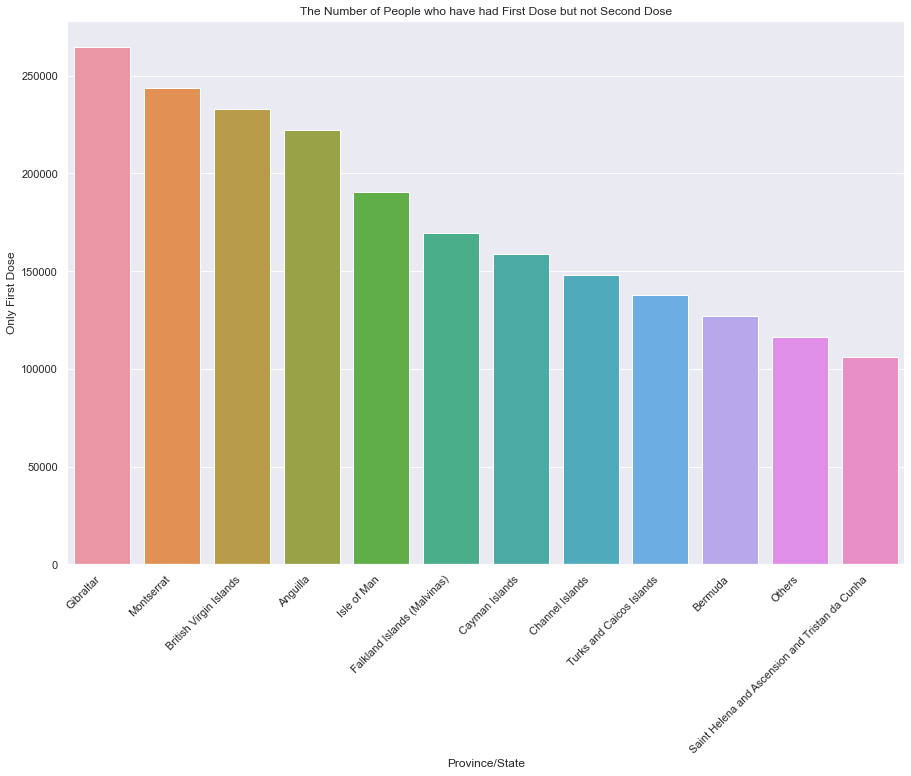

In [405]:
# Plot and Visualise
chart_first_dose_only_absolutes = sns.barplot(x='Province/State', y='Only First Dose', data = first_dose_only_absolutes)
chart_first_dose_only_absolutes.set_xticklabels(chart_first_dose_only_absolutes.get_xticklabels(), 
                                                rotation=45, horizontalalignment='right')
plt.title('The Number of People who have had First Dose but not Second Dose')
plt.show()

In [387]:
# Calculate First Percentage ((the ratio of people who have received the second dose over the first dose)
first_dose_only_absolutes['First Percentage'] = \
100 - (first_dose_only_absolutes['Only First Dose']/first_dose_only_absolutes['First Dose']*100)

In [389]:
# Add Relative Numbers (%) to the Absolutes Dataframe 
first_dose_only_relatives = first_dose_only_absolutes[['Province/State', 'First Dose', 'Second Dose', 
                                                       'Only First Dose', 'First Percentage']]
# Sort and Display
first_dose_only_relatives = first_dose_only_absolutes.sort_values(by=['Only First Dose'], ascending=False)
first_dose_only_relatives

,Province/State,First Dose,Second Dose,Only First Dose,First Percentage
6,Gibraltar,5870786,5606041,264745,95.490468
8,Montserrat,5401128,5157560,243568,95.490423
2,British Virgin Islands,5166303,4933315,232988,95.490237
0,Anguilla,4931470,4709072,222398,95.490229
7,Isle of Man,4226984,4036345,190639,95.489952
5,Falkland Islands (Malvinas),3757307,3587869,169438,95.490440
3,Cayman Islands,3522476,3363624,158852,95.490331
4,Channel Islands,3287646,3139385,148261,95.490360
11,Turks and Caicos Islands,3052822,2915136,137686,95.489878
1,Bermuda,2817981,2690908,127073,95.490637


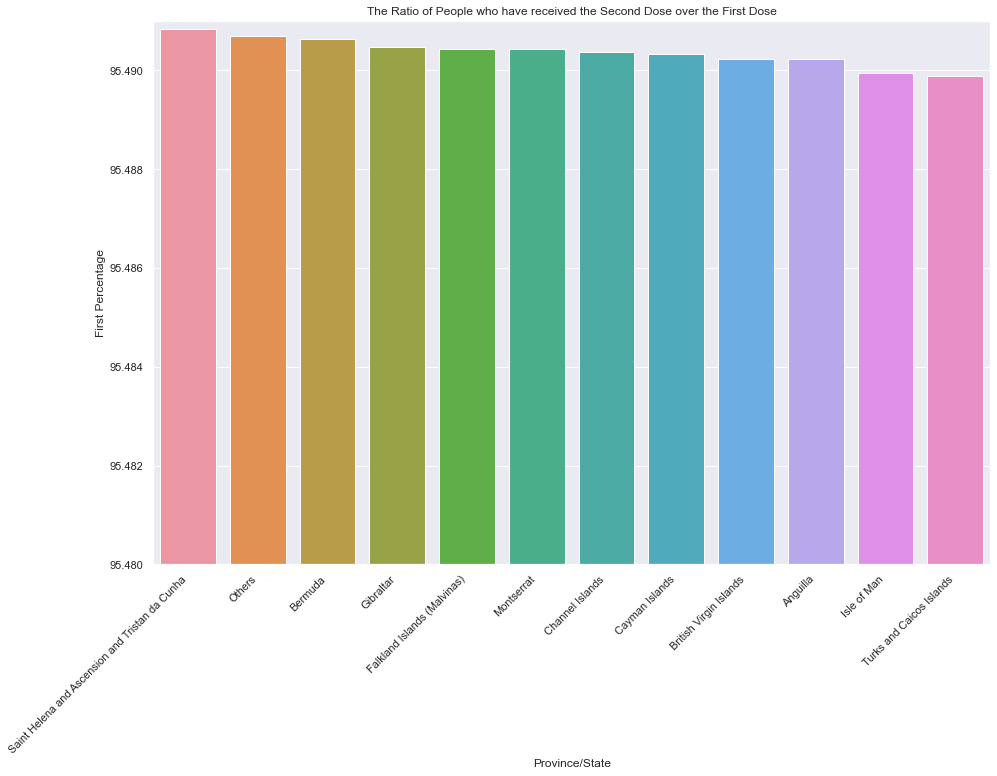

In [403]:
# Plot and Visualise
chart_first_dose_only_relatives = sns.barplot(x='Province/State', y='First Percentage', data = first_dose_only_relatives)
chart_first_dose_only_relatives.set_xticklabels(chart_first_dose_only_relatives.get_xticklabels(), rotation=45, 
                                                horizontalalignment='right')
max_y_lim = 95.491000
min_y_lim = 95.480000
plt.ylim(min_y_lim, max_y_lim)
plt.title('The Ratio of People who have received the Second Dose over the First Dose')
plt.show()

In [447]:
# The dataframe to be used to plot First Dose only (Absolute Numbers) by Province/State and by Year_Month
first_dose_only_by_province_year_month = covid_summary.groupby(['Province/State', 'Year_Month']).sum()
first_dose_only_by_province_year_month

Vaccinated  \
Province/State                                  Year_Month               
Anguilla                                        2020-01              0   
                                                2020-02              0   
                                                2020-03              0   
                                                2020-04              0   
                                                2020-05              0   
                                                2020-06              0   
                                                2020-07              0   
                                                2020-08              0   
                                                2020-09              0   
                                                2020-10              0   
                                                2020-11              0   
                                                2020-12              0   
                                                2021-01          10797   
                                                2021-02          33769   
                                                2021-03         388252   
                                                2021-04        1096605   
                                                2021-05        1131628   
                                                2021-06         767915   
                                                2021-07         553763   
                                                2021-08         481719   
                                                2021-09         209144   
                                                2021-10          35480   
Bermuda                                         2020-01              0   
                                                2020-02              0   
                                                2020-03              0   
                                                2020-04              0   
                                                2020-05              0   
                                                2020-06              0   
                                                2020-07              0   
                                                2020-08              0   
                                                2020-09              0   
                                                2020-10              0   
                                                2020-11              0   
                                                2020-12              0   
                                                2021-01           6169   
                                                2021-02          19299   
                                                2021-03         221860   
                                                2021-04         626631   
                                                2021-05         646642   
                                                2021-06         438808   
                                                2021-07         316442   
                                                2021-08         275270   
                                                2021-09         119512   
                                                2021-10          20275   
British Virgin Islands                          2020-01              0   
                                                2020-02              0   
                                                2020-03              0   
                                                2020-04              0   
                                                2020-05              0   
                                                2020-06              0   
                                                2020-07              0   
                                                2020-08              0   
                                                2020-09         

In [448]:
# Reset index
first_dose_only_by_province_year_month.reset_index(inplace=True)
first_dose_only_by_province_year_month

,Province/State,Year_Month,Vaccinated,First Dose,Second Dose,Deaths,Cases,Recovered,Hospitalised,Only First Dose
0,Anguilla,2020-01,0,0,0,0.0,0.0,0.0,0.0,0
1,Anguilla,2020-02,0,0,0,0.0,0.0,0.0,0.0,0
2,Anguilla,2020-03,0,0,0,0.0,8.0,0.0,5120.0,0
3,Anguilla,2020-04,0,0,0,0.0,89.0,26.0,58314.0,0
4,Anguilla,2020-05,0,0,0,0.0,93.0,93.0,34791.0,0
5,Anguilla,2020-06,0,0,0,0.0,90.0,90.0,15697.0,0
6,Anguilla,2020-07,0,0,0,0.0,93.0,93.0,6521.0,0
7,Anguilla,2020-08,0,0,0,0.0,93.0,93.0,3226.0,0
8,Anguilla,2020-09,0,0,0,0.0,90.0,90.0,4160.0,0
9,Anguilla,2020-10,0,0,0,0.0,93.0,93.0,21905.0,0


In [449]:
# Filter the dataframe to remove the noise (no vaccinations before 01.2021 and 10.2021 data is misleading
first_dose_only_by_province_year_month_abs = first_dose_only_by_province_year_month[['Province/State', 
                                                                                           'Year_Month', 
                                                                                           'Only First Dose']]
first_dose_only_by_province_year_month_abs = first_dose_only_by_province_year_month_abs\
                                            [(first_dose_only_by_province_year_month_abs['Year_Month'] < '2021-10') & 
                                             (first_dose_only_by_province_year_month_abs['Year_Month'] > '2020-12')]
first_dose_only_by_province_year_month_abs

,Province/State,Year_Month,Only First Dose
12,Anguilla,2021-01,725230
13,Anguilla,2021-02,1119036
14,Anguilla,2021-03,753311
15,Anguilla,2021-04,-759054
16,Anguilla,2021-05,-594561
17,Anguilla,2021-06,-202615
18,Anguilla,2021-07,-348443
19,Anguilla,2021-08,-348209
20,Anguilla,2021-09,-127708
34,Bermuda,2021-01,414419


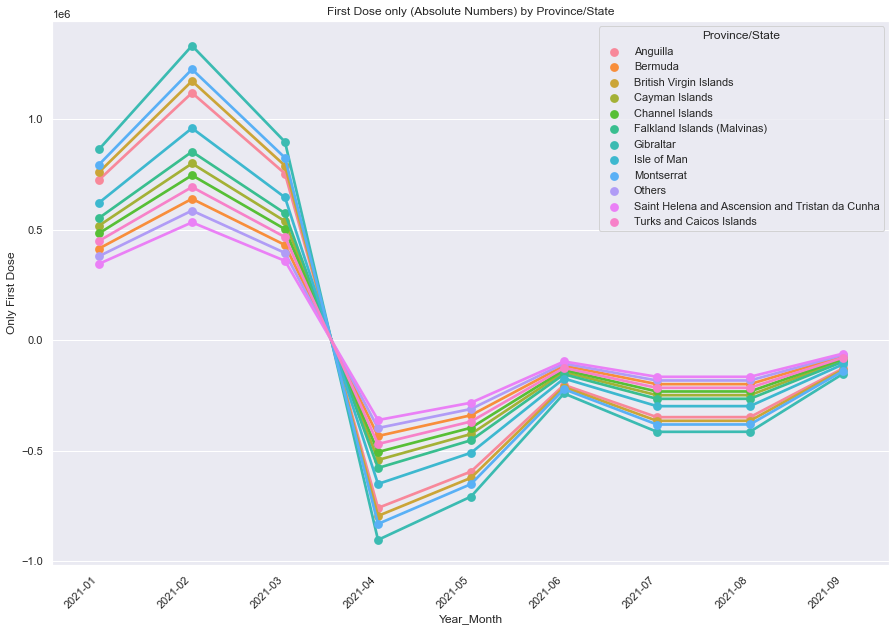

In [453]:
# Pot and Visualise - First Dose only (Absolute Numbers) by Province/State
# Data is already smoothed out the by looking at monthly figures 
chart_first_dose_only_by_province_year_month_abs = sns.pointplot(x="Year_Month", y="Only First Dose",  
                                                                hue="Province/State", bin = 4000,
                                                                data=first_dose_only_by_province_year_month_abs)
chart_first_dose_only_by_province_year_month_abs.set_xticklabels(chart_first_dose_only_by_province_year_month_abs.\
                                                                get_xticklabels(), rotation=45, horizontalalignment='right')
plt.title('First Dose only (Absolute Numbers) by Province/State')
plt.show()

In [ ]:
# Other features evaluated (data preparation, output and plots)

In [454]:
# Dataframe to be used to plot Death numbers by Province/State
# Clean up / drop unnecessary columns 
covid_deaths = covid_summary.drop(columns=['Vaccinated', 'First Dose', 'Second Dose', 
                                    'Cases', 'Recovered', 'Hospitalised', 'Only First Dose'], axis=1)
print(covid_deaths.shape)
covid_deaths

(7584, 5)


,Province/State,Country/Region,Date,Deaths,Year_Month
0,Anguilla,United Kingdom,2020-01-22,0.0,2020-01
1,Anguilla,United Kingdom,2020-01-23,0.0,2020-01
2,Anguilla,United Kingdom,2020-01-24,0.0,2020-01
3,Anguilla,United Kingdom,2020-01-25,0.0,2020-01
4,Anguilla,United Kingdom,2020-01-26,0.0,2020-01
5,Anguilla,United Kingdom,2020-01-27,0.0,2020-01
6,Anguilla,United Kingdom,2020-01-28,0.0,2020-01
7,Anguilla,United Kingdom,2020-01-29,0.0,2020-01
8,Anguilla,United Kingdom,2020-01-30,0.0,2020-01
9,Anguilla,United Kingdom,2020-01-31,0.0,2020-01


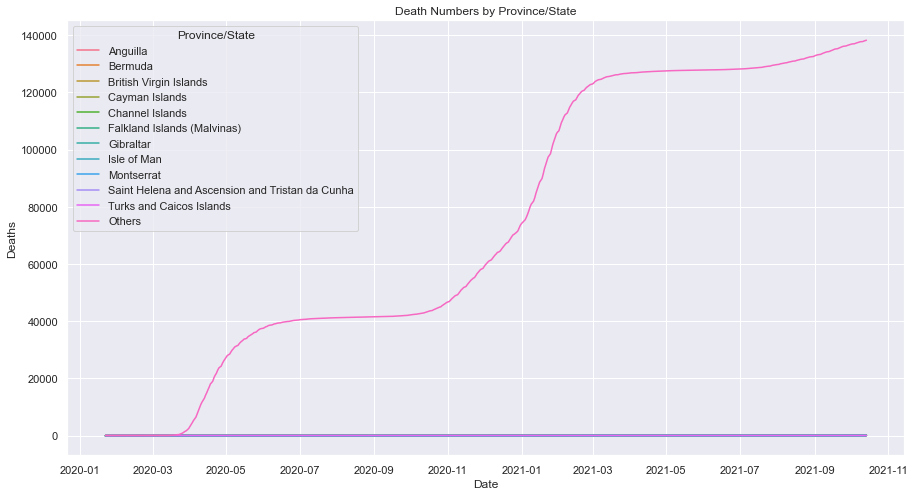

In [490]:
# Create a Lineplot
sns.lineplot(x="Date", y="Deaths", hue = 'Province/State', data = covid_deaths)
sns.set(rc = {'figure.figsize':(15,8)})
plt.title('Death Numbers by Province/State')
plt.show()

In [457]:
# Groupby Province/States to examine the aggregate numbers
covid_deaths_by_province = covid_deaths.groupby(['Province/State']).sum()
covid_deaths_by_province

,Deaths
Province/State,
Anguilla,24.0
Bermuda,10353.0
British Virgin Islands,3573.0
Cayman Islands,911.0
Channel Islands,37130.0
Falkland Islands (Malvinas),0.0
Gibraltar,25412.0
Isle of Man,15051.0
Montserrat,539.0


In [462]:
# Exclude the rows that distort the data 
covid_deaths_excld_Others = covid_deaths[covid_deaths['Province/State'] != 'Others']
print(covid_deaths_excld_Others.shape)
covid_deaths_excld_Others

(6952, 5)


,Province/State,Country/Region,Date,Deaths,Year_Month
0,Anguilla,United Kingdom,2020-01-22,0.0,2020-01
1,Anguilla,United Kingdom,2020-01-23,0.0,2020-01
2,Anguilla,United Kingdom,2020-01-24,0.0,2020-01
3,Anguilla,United Kingdom,2020-01-25,0.0,2020-01
4,Anguilla,United Kingdom,2020-01-26,0.0,2020-01
5,Anguilla,United Kingdom,2020-01-27,0.0,2020-01
6,Anguilla,United Kingdom,2020-01-28,0.0,2020-01
7,Anguilla,United Kingdom,2020-01-29,0.0,2020-01
8,Anguilla,United Kingdom,2020-01-30,0.0,2020-01
9,Anguilla,United Kingdom,2020-01-31,0.0,2020-01


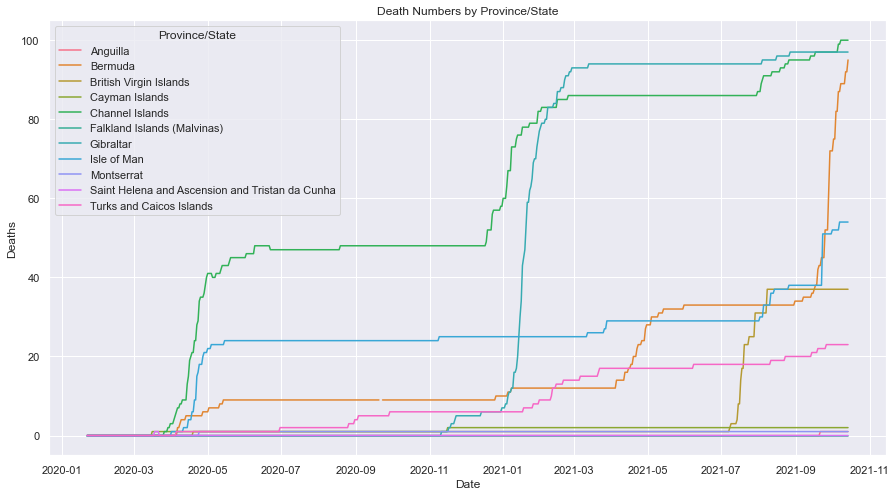

In [464]:
# Create a Lineplot
sns.lineplot(x="Date", y="Deaths", hue = 'Province/State', data = covid_deaths_excld_Others)
sns.set(rc = {'figure.figsize':(15,8)})
plt.title('Death Numbers by Province/State')
plt.show()

In [465]:
# Dataframe to be used to plot Recovered numbers by Province/State
# Clean up / drop unnecessary columns 
covid_recovered = covid_summary.drop(columns=['Vaccinated', 'First Dose', 'Second Dose', 
                                    'Cases', 'Deaths', 'Hospitalised', 'Only First Dose'], axis=1)
print(covid_recovered.shape)
covid_recovered

(7584, 5)


,Province/State,Country/Region,Date,Recovered,Year_Month
0,Anguilla,United Kingdom,2020-01-22,0.0,2020-01
1,Anguilla,United Kingdom,2020-01-23,0.0,2020-01
2,Anguilla,United Kingdom,2020-01-24,0.0,2020-01
3,Anguilla,United Kingdom,2020-01-25,0.0,2020-01
4,Anguilla,United Kingdom,2020-01-26,0.0,2020-01
5,Anguilla,United Kingdom,2020-01-27,0.0,2020-01
6,Anguilla,United Kingdom,2020-01-28,0.0,2020-01
7,Anguilla,United Kingdom,2020-01-29,0.0,2020-01
8,Anguilla,United Kingdom,2020-01-30,0.0,2020-01
9,Anguilla,United Kingdom,2020-01-31,0.0,2020-01


In [487]:
# Filter and Sort
covid_recovered_by_province = covid_recovered.groupby(['Province/State']).sum()
covid_recovered_by_province.reset_index(inplace=True)
covid_recovered_by_province.sort_values(by=['Recovered'], ascending = False)

,Province/State,Recovered
4,Channel Islands,1027626.0
6,Gibraltar,956103.0
11,Turks and Caicos Islands,515923.0
1,Bermuda,363999.0
7,Isle of Man,328319.0
3,Cayman Islands,152052.0
2,British Virgin Islands,64359.0
5,Falkland Islands (Malvinas),14754.0
0,Anguilla,12708.0
8,Montserrat,6376.0


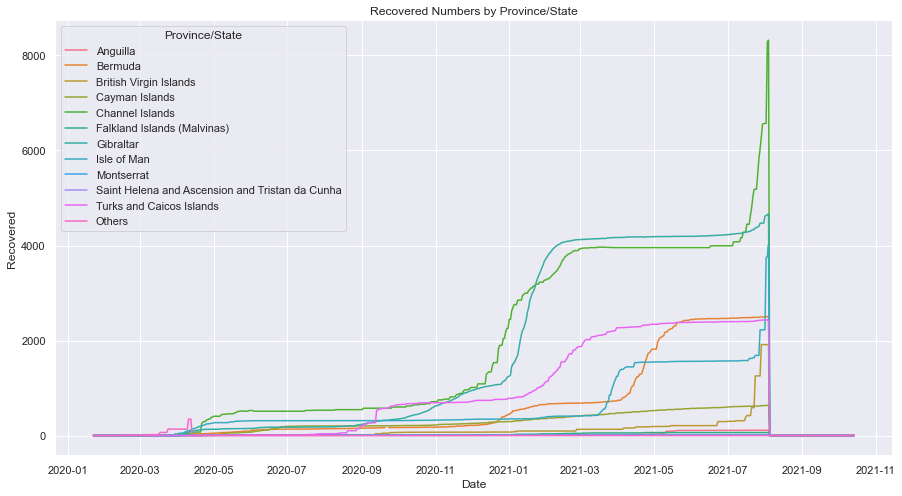

In [488]:
# Create a Lineplot
sns.lineplot(x="Date", y="Recovered", hue = 'Province/State', data = covid_recovered)
sns.set(rc = {'figure.figsize':(15,8)})
plt.title('Recovered Numbers by Province/State')
plt.show()

***Notes and observations:***
Your observations here. (Double click to edit)

***Examples could include:***
- Are there other trends in terms of recoveries or hospitalisations compared to other features that you found interesting and that may add value in terms of the decision making process?
- Any other observations regarding the data?
- Any suggestions for improvements and further analysis?
- What would your future data requirements be?

The highest number of people who have recieved a first dose and not a second dose is in Gibraaltar. Second and third places belong to Montserrat and British Virgin Islands respectively. When we check the percentages graph, we notice Gibraaltar is doing relatively good in terms of Second Dose over First Dose figures (is at the 4th place following Saint Helena, mainland UK and Bermuda). However it should be noted that the percentages for the provinces are pretty close to each other making it difficult to distinguish betwen them.
When we check the distribution of First dose only absolute numbers over time for each Province we see a very similar pattern for each every one of them. It is always better to check additional features to get a broader insight.

-When we check the death numbers by Province, we see a single lined graph implying that one of the Provinces is dominating over the others. When we check the aggregate numbers we realise that Mainland UK numbers are approaching to 47 million implying that the death figures are cumulative. When we leave the 'Others' data to the side, we see that Gibraaltar has the highest figures together with Channel Islands. 

-When we check the recovery figures, we see that Gibraaltar is doing good in this part again together with Channel Island. However Recovery data seems less reliable as there are no figures available after 05.08.2021 pointing to a system or process related problem.

Before we proceed, it is good to note that considering different perspective when analysing data is essential. Realising the caveats (such as misleading 'Others' figures) or finding better ways to consume data (such as switching from datily figures to monthly ones) will always help in getting closer to the desired outcomes.

As a summing up thought, although, Gibraaltar could be targeted, it would be much better to reach out for some qualitative data as well as additional quantitative data (how many people qualify for vaccinations in each region) before coming to a conclusion.

### 5) Assignment activity 5: External data: [Analyse the Twitter data](https://fourthrev.instructure.com/courses/313/pages/assignment-activity-5-analyse-the-twitter-data?module_item_id=21383)
In the next section, you were supplied with a sample file and the question was asked to determine whether there are additional #tags or keywords that could potentially provide insights into your covid analysis. While the sample set is limited, you were asked to review the provided file and demonstrate the typical steps and make recommendations regarding future use of similar datasets to provide richer insights.

#### 5.1) Report expectations:
- Demonstrate basic ability to work with Twitter data
- Search for hash-tags or keywords
- Create dataframes and visualisations
- Note observations

In [4]:
# Import the tweet dataset (`tweets_2.csv`)
tweet_data = pd.read_csv('tweets_2.csv')

In [6]:
# Explore the data: info(), head()
tweet_data.info()
tweet_data.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 29 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   created_at                 100 non-null    object 
 1   id                         100 non-null    int64  
 2   id_str                     100 non-null    int64  
 3   text                       100 non-null    object 
 4   truncated                  100 non-null    bool   
 5   entities                   100 non-null    object 
 6   metadata                   100 non-null    object 
 7   source                     100 non-null    object 
 8   in_reply_to_status_id      8 non-null      float64
 9   in_reply_to_status_id_str  8 non-null      float64
 10  in_reply_to_user_id        11 non-null     float64
 11  in_reply_to_user_id_str    11 non-null     float64
 12  in_reply_to_screen_name    11 non-null     object 
 13  user                       100 non-null    object 


,created_at,id,id_str,text,truncated,entities,metadata,source,in_reply_to_status_id,in_reply_to_status_id_str,...,retweet_count,favorite_count,favorited,retweeted,lang,possibly_sensitive,quoted_status_id,quoted_status_id_str,quoted_status,extended_entities
0,Mon Mar 21 21:45:28 +0000 2022,1506024218571464717,1506024218571464717,@Johnrashton47 When #diabetes has been the big...,True,"{'hashtags': [{'text': 'diabetes', 'indices': ...","{'iso_language_code': 'en', 'result_type': 're...","<a href=""http://twitter.com/download/android"" ...",1.505660e+18,1.505660e+18,...,0,0,False,False,en,NaN,NaN,NaN,NaN,NaN
1,Mon Mar 21 21:31:13 +0000 2022,1506020629849391104,1506020629849391104,Disturbing figures from @fsb_policy @indparltr...,True,"{'hashtags': [], 'symbols': [], 'user_mentions...","{'iso_language_code': 'en', 'result_type': 're...","<a href=""http://twitter.com/download/android"" ...",NaN,NaN,...,4,3,False,False,en,False,NaN,NaN,NaN,NaN
2,Mon Mar 21 19:04:53 +0000 2022,1505983803822592004,1505983803822592004,NEW: #Stormont MLAs voted 57 ~ 25 to extend Do...,True,"{'hashtags': [{'text': 'Stormont', 'indices': ...","{'iso_language_code': 'en', 'result_type': 're...","<a href=""http://twitter.com/download/iphone"" r...",NaN,NaN,...,2,9,False,False,en,False,NaN,NaN,NaN,NaN
3,Mon Mar 21 18:39:58 +0000 2022,1505977533841481731,1505977533841481731,I'm do sick of coming on twitter to see the sa...,True,"{'hashtags': [{'text': 'borisOut', 'indices': ...","{'iso_language_code': 'en', 'result_type': 're...","<a href=""http://twitter.com/download/android"" ...",NaN,NaN,...,0,0,False,False,en,NaN,NaN,NaN,NaN,NaN
4,Mon Mar 21 18:23:08 +0000 2022,1505973299502850052,1505973299502850052,The rollout of new #COVID19 #Booster jabs to #...,True,"{'hashtags': [{'text': 'COVID19', 'indices': [...","{'iso_language_code': 'en', 'result_type': 're...","<a href=""https://mobile.twitter.com"" rel=""nofo...",NaN,NaN,...,0,1,False,False,en,False,NaN,NaN,NaN,NaN


In [262]:
# Explore the structure, count the tweets, get the elements of interest
print(tweet_data.shape)
print(tweet_data.dtypes)

(100, 29)
created_at                    object
id                             int64
id_str                         int64
text                          object
truncated                       bool
entities                      object
metadata                      object
source                        object
in_reply_to_status_id        float64
in_reply_to_status_id_str    float64
in_reply_to_user_id          float64
in_reply_to_user_id_str      float64
in_reply_to_screen_name       object
user                          object
geo                           object
coordinates                   object
place                         object
contributors                 float64
is_quote_status                 bool
retweet_count                  int64
favorite_count                 int64
favorited                       bool
retweeted                       bool
lang                          object
possibly_sensitive            object
quoted_status_id             float64
quoted_status_id_str        

In [265]:
# Explore the structure, count the tweets, get the elements of interest - list the most retweeted tweets
tweet_data['retweet_count'].value_counts().sort_index(ascending=False)

32     1
17     1
8      1
5      1
4      2
3      3
2      6
1     16
0     69
Name: retweet_count, dtype: int64

In [ ]:
tweet_data['retweet_count']

In [278]:
# Extract the details of the most retweeted tweet
most_retweeted_tweet = tweet_data[tweet_data['retweet_count'] == 32]
most_retweeted_tweet 

,created_at,id,id_str,text,truncated,entities,metadata,source,in_reply_to_status_id,in_reply_to_status_id_str,...,retweet_count,favorite_count,favorited,retweeted,lang,possibly_sensitive,quoted_status_id,quoted_status_id_str,quoted_status,extended_entities
6,Mon Mar 21 16:46:01 +0000 2022,1505948855698870275,1505948855698870275,Dear @sajidjavid are NHS staff meant to do twi...,True,"{'hashtags': [], 'symbols': [], 'user_mentions...","{'iso_language_code': 'en', 'result_type': 're...","<a href=""http://twitter.com/download/iphone"" r...",NaN,NaN,...,32,75,False,False,en,False,NaN,NaN,NaN,NaN


In [266]:
# Explore the structure, count the tweets, get the elements of interest - list the most favorite tweets
tweet_data['favorite_count'].value_counts().sort_index(ascending=False)

97     1
75     1
63     1
32     1
26     1
23     1
20     1
17     1
15     1
14     1
9      3
8      2
7      3
6      3
5      6
4      8
3      6
2      8
1     12
0     39
Name: favorite_count, dtype: int64

In [279]:
# Extract the details of the most favorite tweet
most_favorite_tweet = tweet_data[tweet_data['favorite_count'] == 97]
most_favorite_tweet 

,created_at,id,id_str,text,truncated,entities,metadata,source,in_reply_to_status_id,in_reply_to_status_id_str,...,retweet_count,favorite_count,favorited,retweeted,lang,possibly_sensitive,quoted_status_id,quoted_status_id_str,quoted_status,extended_entities
35,Sun Mar 20 12:29:28 +0000 2022,1505521907063566336,1505521907063566336,Has anyone not had #covid19 yet? That you know...,True,"{'hashtags': [{'text': 'covid19', 'indices': [...","{'iso_language_code': 'en', 'result_type': 're...","<a href=""http://twitter.com/download/iphone"" r...",NaN,NaN,...,2,97,False,False,en,NaN,NaN,NaN,NaN,NaN


In [282]:
# Create a series with the text only
tweet_data_text = tweet_data ['text']
tweet_data_text

0     @Johnrashton47 When #diabetes has been the big...
1     Disturbing figures from @fsb_policy @indparltr...
2     NEW: #Stormont MLAs voted 57 ~ 25 to extend Do...
3     I'm do sick of coming on twitter to see the sa...
4     The rollout of new #COVID19 #Booster jabs to #...
5     Trying to keep a mask in inside to see if we c...
6     Dear @sajidjavid are NHS staff meant to do twi...
7     #breaking #ShanghaiDisneyland is closed from t...
8     Just cancelled our (thankfully cheap &amp; che...
9     Once again out of dozens of customers I was th...
10    Huge thanks to everyone involved in bringing t...
11    The set is up! Production starting this week!!...
12    Last week committee mertings on "The Frauds ar...
13    Thank You @aimeeeieio ♥️♥️♥️ #COVID19 goodies ...
14    Covid has finally got me and about of half the...
15    God almighty I need to paint the entire lounge...
16    The number of people in #hospital with #COVID1...
17    Most of the remaining legal #COVID19 restr

In [283]:
# Loop through the messages and build a list of values containing the #-symbol
tweet_data_text_hashtags = tweet_data_text.str.extractall(r'(?P<Hashtags>\#\w*)')
tweet_data_text_hashtags

Hashtags
   match                          
0  0                     #diabetes
   1                      #COVID19
2  0                     #Stormont
   1                      #covid19
3  0                     #borisOut
   1               #BrexitDisaster
   2                        #Trans
   3                      #COVID19
4  0                      #COVID19
   1                      #Booster
   2                   #vulnerable
   3                    #IsleofMan
5  0                      #COVID19
7  0                     #breaking
   1           #ShanghaiDisneyland
   2                      #COVID19
   3                        #China
10 0                      #COVID19
   1                #StPatricksDay
11 0                   #Television
   1                   #University
   2      #UniversityofWestminster
   3                  #competition
12 0                      #COVID19
   1                         #hmrc
   2                      #banking
13 0                      #COVID19
   1               #CovidIsNotOver
16 0                     #hospital
   1                      #COVID19
   2                        #Devon
17 0                      #COVID19
   1                     #Scotland
18 0                    #carehomes
   1                       #immune
21 0                      #COVID19
   1                        #covid
   2             #CovidVaccination
22 0                      #COVID19
23 0                     #HongKong
   1                      #COVID19
24 0                      #covid19
26 0                      #Erasmus
   1                      #COVID19
28 0                      #Johnson
   1                       #Brexit
   2                      #Ukraine
   3                       #Russia
32 0                      #COVID19
33 0                    #Partygate
   1                      #COVID19
34 0                      #COVID19
35 0                      #covid19
36 0                #RecoveryTrial
37 0                      #COVID19
38 0                      #COVID19
   1                 #vaccinations
   2              #testingpositive
39 0                      #COVID19
   1                  #coronavirus
   2                    #covid19UK
40 0                      #COVID19
41 0                      #COVID19
42 0            #lostsmellandtaste
   1                      #COVID19
   2                      #covid19
43 0          #friday20thmarch2020
   1         #marinadalglishcentre
44 0                        #China
   1                      #COVID19
46 0                      #COVID19
47 0                      #COVID19
48 0                       #Russia
   1                      #Ukraine
   2                       #Brexit
49 0                      #COVID19
50 0                     #Covid_19
   1                      #COVID19
   2                        #COVID
   3                        #sleep
   4                     #insomnia
51 0                         #Uber
   1                      #COVID19
52 0                    #fieldsing
   1                  #fieldsinger
   2        #accentuatethepositive
   3                    #spreadjoy
53 0                       #Athens
   1                       #Greece
57 0                      #COVID19
58 0                      #COVID19
   1                 #WARINUKRAINE
61 0                    #Partygate
   1                   #Corruption
   2                          #PPE
   3                      #Covid19
62 0                      #COVID19
66 0                      #COVID19
68 0                 #BorisJohnson
   1                      #covid19
70 0                    #fuckcovid
   1                      #COVID19
   2                  #coronavirus
71 0                      #COVID19
72 0                        #covid
73 0                       #Uganda
   1                      #COVID19
   2                        #masks
74 0                      #COVID19
   1                     #LasVegas
75 0                      #COVID19
76 0                      #Croydon
   1                      #COVID19
7

In [104]:
# Count the number of tweets per hashtag
hashtags_counts = tweet_data_text.str.extractall(r'(?P<Hashtags>\#\w+)').value_counts()
print(hashtags_counts)

Hashtags                
#COVID19                    55
#covid19                     7
#coronavirus                 3
#CovidIsNotOver              3
#covid                       2
#Partygate                   2
#Ukraine                     2
#China                       2
#Russia                      2
#Brexit                      2
#COVID                       1
#IsleofMan                   1
#Johnson                     1
#LasVegas                    1
#Leadership                  1
#Management                  1
#MaskUp                      1
#Motivation                  1
#Booster                     1
#NHSCrisis                   1
#NorthernIreland             1
#Omicron                     1
#PPE                         1
#BA2                         1
#RNAseq                      1
#RecoveryTrial               1
#JIC                         1
#Innovation                  1
#Corona                      1
#HongKong                    1
#BorisJohnson                1
#Greece       

In [101]:
# Check the number of unique hashtags
counts.size

84

In [134]:
# Convert hashtags_counts series to a dataframe
hashtags_counts_df = hashtags_counts.to_frame(name = 'Count of Hashtags')
hashtags_counts_df

,Count of Hashtags
Hashtags,
#COVID19,55
#covid19,7
#coronavirus,3
#CovidIsNotOver,3
#covid,2
#Partygate,2
#Ukraine,2
#China,2
#Russia,2


In [136]:
# Reset Index
hashtags_counts_df.reset_index(inplace=True)

In [137]:
# Explore the data structure
hashtags_counts_df.dtypes

Hashtags             object
Count of Hashtags     int64
dtype: object

In [138]:
# Display 30 records
hashtags_counts_df.head(30)

,Hashtags,Count of Hashtags
0,#COVID19,55
1,#covid19,7
2,#coronavirus,3
3,#CovidIsNotOver,3
4,#covid,2
5,#Partygate,2
6,#Ukraine,2
7,#China,2
8,#Russia,2
9,#Brexit,2


In [141]:
# Identify the possible covid related hashtags and mark them in the dataframe
# Note that only the obvious covid related tags are added to the list. 
# Some other possible tags (eg. NHS, immune, diabets, hospital, carehomes, lostsmellandtaste, testingpositive) 
# are left out to be on the safe side 

covid_related =['covid', 'corona', 'vacc', 'omicron', 'booster', 'mask', 'ppe', 'pandemic']

def matcher(x):
    for i in covid_related:
        if i.lower() in x.lower():
            return i
    else:
        return np.nan

hashtags_counts_df['Match'] = hashtags_counts_df['Hashtags'].apply(matcher)

In [140]:
hashtags_counts_df

,Hashtags,Count of Hashtags,Match
0,#COVID19,55,covid
1,#covid19,7,covid
2,#coronavirus,3,corona
3,#CovidIsNotOver,3,covid
4,#covid,2,covid
5,#Partygate,2,NaN
6,#Ukraine,2,NaN
7,#China,2,NaN
8,#Russia,2,NaN
9,#Brexit,2,NaN


In [146]:
# Replace NaN's with O's
hashtags_counts_df_plot = hashtags_counts_df.fillna(0)
hashtags_counts_df_plot 

,Hashtags,Count of Hashtags,Match
0,#COVID19,55,covid
1,#covid19,7,covid
2,#coronavirus,3,corona
3,#CovidIsNotOver,3,covid
4,#covid,2,covid
5,#Partygate,2,0
6,#Ukraine,2,0
7,#China,2,0
8,#Russia,2,0
9,#Brexit,2,0


In [293]:
# Filter the rows with covid related hashtags
hashtags_counts_df_plot_bar = hashtags_counts_df_plot[hashtags_counts_df_plot['Match'] != 0]
hashtags_counts_df_plot_bar


,Hashtags,Count of Hashtags,Match
0,#COVID19,55,covid
1,#covid19,7,covid
2,#coronavirus,3,corona
3,#CovidIsNotOver,3,covid
4,#covid,2,covid
10,#COVID,1,covid
16,#MaskUp,1,mask
18,#Booster,1,booster
21,#Omicron,1,omicron
22,#PPE,1,ppe


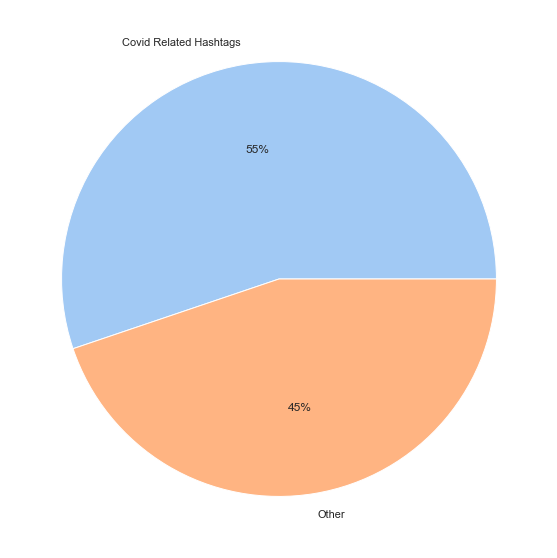

In [307]:
# Plot - Covid Related Hashtags vs Other Hashtags

# Calculate the percentage of covid related hashtags
covid_related_hashtags_percent = (hashtags_counts_df_plot_bar['Count of Hashtags'].sum())*100/\
                                (hashtags_counts_df['Count of Hashtags'].sum())

# Calculate the percentage of non-covid related hashtags
other_hashtags_percent = (hashtags_counts_df['Count of Hashtags'].sum()\
                          -hashtags_counts_df_plot_bar['Count of Hashtags'].sum())*100/\
                        (hashtags_counts_df['Count of Hashtags'].sum())

#Define pie chart parameters
data = [covid_related_hashtags_percent, other_hashtags_percent]
labels = ['Covid Related Hashtags', 'Other']

#Define Seaborn color palette to use
colors = sns.color_palette('pastel')[0:5]

#Create pie chart
plt.pie(data, labels = labels, colors = colors, autopct='%.0f%%')
plt.show()



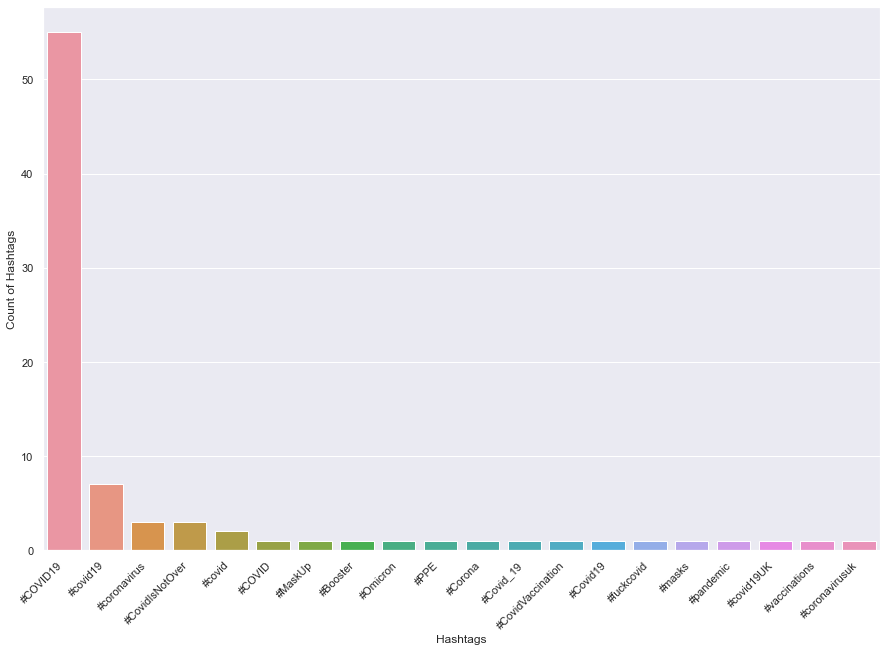

In [305]:
# Plot - Trending Covid Related Hashtags
chart_covid_related_hashtags_counts = sns.barplot(x='Hashtags', y='Count of Hashtags', 
                                                  data = hashtags_counts_df_plot_bar, ax = None)
chart_covid_related_hashtags_counts.set_xticklabels(chart_covid_related_hashtags_counts.get_xticklabels(), 
                                                    rotation=45, horizontalalignment='right')
plt.show()

Patterns and trends: An elaborated account of the identified patterns and trends is evident along with a discussion of why they appear in the data as well as detailing how these trends can possibly impact the results.

It is clear from the data that Covid is still a trending topic in Twitter. More than %55 of the scrapped tweets talk about Covid (this is the lower bound, only the most common covid related hashtags are included into the calculation). The subtopics are various, ranging from masks to vaccinations. 


Note the assumptions and limitations of the data: 
*The analysis is based on limited data, scrapped in one single day. 
*The calculations are based on hashtag analysis and comments are articulated on the assumption that the hastags are evenly distributed among tweets. In real life, although Twitter recommends no more than two relevant hashtags per tweet, one can use as many hashtags as you like in a Tweet, within the 280-character limit. Moreover, the hashtags that seem to non-covid related can turn out be covid related (eg. Partygate) and vice versa (eg. Erasmus project is happening after 2yrs of #COVID19).

#### 5.2) Presentation expectations:
Discuss whether external data could potentially be used and whether it is a viable solution to pursue. Discuss your assumptions and suggestions. 

Points to consider:
- What insights can be gained from the data?
- What are the advantages and disadvantages of using external data?
- How would you suggest using external data in the project?

To support the launch of marketing campaigns to promote vaccination, utilising qualitative data is as crutial as the quantitative data. Twitter data is a good source to understand the dynamics behind behaviour patterns. 
In each region a similar analysis can be conducted. It would be wise to go into one step further conduct some text classifying exercise to have a broader understanding of the users' intentions behind messages (eg. in a specific region, people may be avoiding second dose vaccinations due to long queues in vaccination centers). Using only Twitter, to gain insight on public opinion would be limitting as Twitter would not be reflecting the general society view, but it is definitely a good and inexpensiveway to start. 

On the other hand, the reliability of external data is difficult to pin-point accurately. Also, finding relevant information can be difficult would need extra resources.

### 6) Assignment activity 6: [Perform time-series analysis](https://fourthrev.instructure.com/courses/313/pages/assignment-activity-6-perform-time-series-analysis?module_item_id=22584)

#### 6.1) Report expectations:
- Demonstrate using external function and interpret results
- Note observations

Question1- The consultant indicated that the function is functional, but did not demonstrate how to use it. Use the provided function, plot_moving_average(), to plot the data for the selected province (variable name is sample_ci and set the window parameter to 7 days

In [185]:
# Libraries and settings
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

%matplotlib inline

In [186]:
# Load and select relevant subset of the data.
# Make sure to change the relative path to function in your environment.
ds1 = pd.read_csv('covid_19_uk_cases_BYA.csv')
ds2 = pd.read_csv('covid_19_uk_vaccinated_BYA.csv')

sample = ds1[['Province/State','Date','Hospitalised', 'Cases']]
ds1['Date'] = pd.to_datetime(ds1['Date'])

ds1.dtypes

Province/State                      object
Country/Region                      object
Lat                                float64
Long                               float64
ISO 3166-1 Alpha 3-Codes            object
Sub-region Name                     object
Intermediate Region Code             int64
Date                        datetime64[ns]
Deaths                             float64
Cases                              float64
Recovered                          float64
Hospitalised                       float64
dtype: object

In [241]:
# Select data for a specific province
sample_ci = sample[sample['Province/State'] == 'Channel Islands']
sample_ci

,Province/State,Date,Hospitalised,Cases
2528,Channel Islands,2020-01-22,0.0,0.0
2529,Channel Islands,2020-01-23,0.0,0.0
2530,Channel Islands,2020-01-24,0.0,0.0
2531,Channel Islands,2020-01-25,0.0,0.0
2532,Channel Islands,2020-01-26,0.0,0.0
2533,Channel Islands,2020-01-27,0.0,0.0
2534,Channel Islands,2020-01-28,0.0,0.0
2535,Channel Islands,2020-01-29,0.0,0.0
2536,Channel Islands,2020-01-30,0.0,0.0
2537,Channel Islands,2020-01-31,0.0,0.0


In [197]:
# Define function to plot moving averages
def plot_moving_average(series, window, plot_intervals=False, scale=1.96):
    
    # Create a rolling window to calculate the rolling mean using the series.rolling function
    rolling_mean = series.rolling(window=window).mean()
    
    # Declare the dimensions for the plot, plot name and plot the data consisting of the rolling mean from above. 
    plt.figure(figsize=(18,4))
    plt.title('Moving average\n window size = {}'.format(window))
    plt.plot(rolling_mean, 'g', label='Simple moving average trend')

    
    # Plot confidence intervals for smoothed values
    if plot_intervals:
        
        # Calculate the mean absolute square 
        mae = mean_absolute_error(series[window:], rolling_mean[window:])
        
        # Calculate the standard deviation using numpy's std function
        deviation = np.std(series[window:] - rolling_mean[window:])
        
        # Calculate the upper and lower bounds 
        lower_bound = rolling_mean - (mae + scale * deviation)
        upper_bound = rolling_mean + (mae + scale * deviation)
        
        # Name and style upper and lower bound lines and labels 
        plt.plot(upper_bound, 'r--', label='Upper bound / Lower bound')
        plt.plot(lower_bound, 'r--')
    
    # Plot the actual values for the entire timeframe.
    plt.plot(series[window:], label='Actual values')
    plt.grid(True)

In [198]:
# Define function to calculate the mean absolute error
def mean_absolute_error(a, b): return abs(b - a)

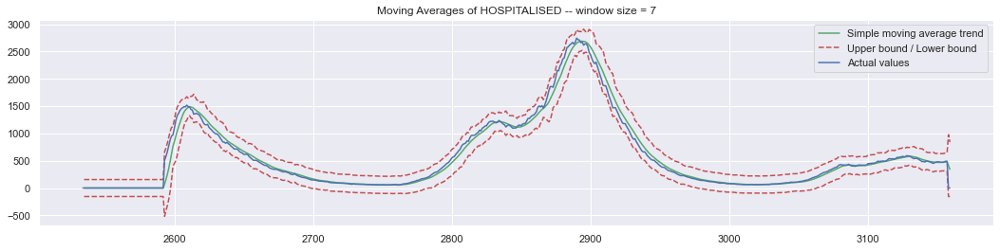

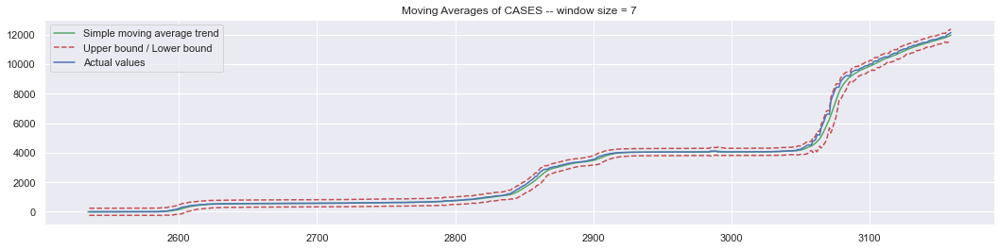

In [245]:
# Demonstrate the use of the function to plot moving averages

# Hospitalised in Channel Islands
# window = 7 days
plot_moving_average(sample_ci.Hospitalised, 7, plot_intervals=True)
plt.title('Moving Averages of HOSPITALISED -- window size = 7')
plt.legend(loc='best')

# Cases in Channel Islands
# window = 7 days
plot_moving_average(sample_ci['Cases'], 7, plot_intervals=True)
plt.title('Moving Averages of CASES -- window size = 7')
plt.legend(loc='best')

Patterns and trends: An elaborated account of the identified patterns and trends is evident along with a discussion of why they appear in the data as well as detailing how these trends can possibly impact the results.

The main advantage of the SMA here is that it offers a smoothed line. Smoothing time series data helps reveal the underlying trends in the data. These charts can be utilised in the marketing campaigns as when presented together and compared with each other they can easily interpreted as follows:
Covid is not over, the cas numbers are still on the rise. However due to the successful vaccınation policies, the hospital admission rates decreased significantly. The coronavirus could end up mild like a common cold, if and only if the vaccinations are taken seriously.

Question 2 - The consultant performed a calculation that looks interesting, but the team is unsure about what the intention was and how to interpret the output. Can you offer some insights into the meaning of the code and output in the cell below? Is it useful?

In [212]:
# Return top three days with biggest difference between daily value and rolling 7-day mean
s = sample_ci.copy()
s_rolling = s['Hospitalised'].rolling(window=7).mean()
s['error'] = mean_absolute_error(s['Hospitalised'][7:], s_rolling[7:])
s.sort_values('error', ascending=False).head(3)

,Province/State,Date,Hospitalised,Cases,error
2593,Channel Islands,2020-03-27,509.0,88.0,436.285714
2594,Channel Islands,2020-03-28,579.0,97.0,423.571429
2595,Channel Islands,2020-03-29,667.0,108.0,416.285714


The standard deviation (SD) measures the amount of variability, or dispersion, from the individual data values to the mean, while the standard error of the mean (SEM) measures how far the sample mean (average) of the data is likely to be from the true population mean.

In this case 'error' is SEM and used in defining the upper and lower bounds (confidence intervals). 
lower_bound = rolling_mean - ('error' + 1.96 * deviation)
upper_bound = rolling_mean + ('error' + 1.96 * deviation)

A high standard error shows that sample data are widely spread around the population mean—your sample may not closely represent your population. A low standard error shows that sample means are closely distributed around the population mean—your sample is representative of your population. The more data points involved in the calculations of the mean, the smaller the standard error tends to be. 

Please also note that: 95% of the area under a normal curve lies within roughly (1.96 standard deviations + 'error') of the mean, and due to the central limit theorem, here scale = 1.96 is therefore used in the construction of approximate 95% confidence intervals.

#### 6.2) Presentation expectations:
- **Question 1**: We have heard of both qualitative and quantitative data from the previous consultant. What are the differences between the two? Should we use only one or both of these types of data and why? How can these be used in business predictions? Could you provide examples of each?
- **Question 2**: We have also heard a bit about the need for continuous improvement. Why should this be implemented, it seems like a waste of time. Why can’t we just implement the current project as it stands and move on to other pressing matters?
- **Question 3**: As a government, we adhere to all data protection requirements and have good governance in place. We only work with aggregated data and therefore will not expose any personal details. We have covered everything from a data ethics standpoint, correct? There’s nothing else we need to implement from a data ethics perspective, right?

Answer1 Quantitative data such as market size, demographics, and cost figures etc provides important information for business decisions. On the other hand qualitative data help to understand user needs, behavior patterns, and use cases. Twitter sentiment analysis would be qualitative data, where as number of likes or retweets of a specific hastag would be quantitative data.

Answer2 In a project cycle, checking and reviewing how the project is being implemented is a crucial step in learning from experience, identifying the best practices and identifying the improvement opprtunities.

Answer3 All organisations must set and follow ethical standards for data collection, manipulation, and use. Data privacy is only one part of the big picture.